## <span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;"> Passenger Satisfaction Prediction
<a id='measures'></a>

<font color=darkblue> **Description**

**Objective**

Using the survey data to predict whether the customer will be satisfied or dissatisfied with the services that Airline is providing.
    
The problem consists of 2 separate datasets: Flight data & Survey data. The flight data has information related to passengers and the performance of flights in which they travelled. The survey data is the aggregated data of surveys collected post service experience. You are expected to treat both the datasets as raw data and perform any necessary cleaning/validation steps as required.

**Data Dictionary**

Survey details (options from 0:extremely poor to 5: excellent):

* Satisfaction: Overall Score
* Seat Comfort
* Inflight wifi service
* On-board service
* Cleanliness
* Departire/Arrival time convenience
* Inflight enternainment
* Leg room service
* Online boarding
* Food and drink
* Online support
* Baggage handling
* Gate location
* Ease of online booking
* Checkin service
    
Flight Data: 
* Gender
* CustomerType
* Age
* TypeTravel
* Class
* Flight_Distance
* DepartureDelayin_Mins
* ArrivalDelayin_Mins
        
  </font> 

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">i. Loading the libraries:

In [1]:
import numpy as np 
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
sns.set(color_codes=True) #background for the graphs
%matplotlib inline 
import warnings
warnings.filterwarnings('ignore') #To supress warnings
from scipy import stats
import copy
class style:
   BOLD = '\033[1m'
   END = '\033[0m'
import warnings
import statsmodels.api as sm
from statsmodels.sandbox.regression.predstd import wls_prediction_std
warnings.filterwarnings("ignore")
from sklearn.model_selection import train_test_split
from sklearn import linear_model
import statsmodels.api as sm
from sklearn import metrics
from sklearn import datasets
from statsmodels.stats.outliers_influence import variance_inflation_factor
import seaborn as sns
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn import tree
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import StackingClassifier
%matplotlib inline

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">ii. Importing the datasets:

In [2]:
survey = pd.read_csv("Marketing Project-Survey data.csv") #Import the dataset named 'Marketing Project-Survey data.csv'

In [3]:
survey.info() #Checking the column names

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90917 entries, 0 to 90916
Data columns (total 16 columns):
 #   Column                             Non-Null Count  Dtype 
---  ------                             --------------  ----- 
 0   CustomerId                         90917 non-null  int64 
 1   Satisfaction                       90917 non-null  object
 2   Seat_comfort                       90917 non-null  object
 3   Departure.Arrival.time_convenient  82673 non-null  object
 4   Food_drink                         82736 non-null  object
 5   Gate_location                      90917 non-null  object
 6   Inflightwifi_service               90917 non-null  object
 7   Inflight_entertainment             90917 non-null  object
 8   Online_support                     90917 non-null  object
 9   Ease_of_Onlinebooking              90917 non-null  object
 10  Onboard_service                    83738 non-null  object
 11  Leg_room_service                   90917 non-null  object
 12  Bagg

In [4]:
Survey = survey.rename(columns={'Departure.Arrival.time_convenient': 'DepartureArrivaltime_convenient'}, inplace = False) 
#Change column name Departure.Arrival.time_convenient to DepartureArrivaltime_convenient to avoid syntax issues

In [5]:
flight = pd.read_csv("Marketing Project-Flight data.csv") #Import the dataset named 'Marketing Project-Flight data.csv'

In [6]:
flight.info() #Checking the column names

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90917 entries, 0 to 90916
Data columns (total 9 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   CustomerID             90917 non-null  int64  
 1   Gender                 90917 non-null  object 
 2   CustomerType           81818 non-null  object 
 3   Age                    90917 non-null  int64  
 4   TypeTravel             81829 non-null  object 
 5   Class                  90917 non-null  object 
 6   Flight_Distance        90917 non-null  int64  
 7   DepartureDelayin_Mins  90917 non-null  int64  
 8   ArrivalDelayin_Mins    90633 non-null  float64
dtypes: float64(1), int64(4), object(4)
memory usage: 6.2+ MB


In [7]:
Flight = flight.rename(columns={'CustomerID': 'CustomerId'}, inplace = False) #Change column name CustomerID to CustomerId

In [8]:
data = pd.merge(Survey, Flight, how='outer', on='CustomerId') #New merged dataset

#### Observations
* Customer ID column had to be renamed in order to merge databases with full-outer join union

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">iii. Checking the dimension of data:

In [9]:
data.shape #To review the number of observations available per variable of interest

(90917, 24)

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">iv. Checking the data types available:

In [10]:
data.info() 
#to evaluate the data frame in terms of type to define is variables are categorical (qualitative) or quantitative

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90917 entries, 0 to 90916
Data columns (total 24 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   CustomerId                       90917 non-null  int64  
 1   Satisfaction                     90917 non-null  object 
 2   Seat_comfort                     90917 non-null  object 
 3   DepartureArrivaltime_convenient  82673 non-null  object 
 4   Food_drink                       82736 non-null  object 
 5   Gate_location                    90917 non-null  object 
 6   Inflightwifi_service             90917 non-null  object 
 7   Inflight_entertainment           90917 non-null  object 
 8   Online_support                   90917 non-null  object 
 9   Ease_of_Onlinebooking            90917 non-null  object 
 10  Onboard_service                  83738 non-null  object 
 11  Leg_room_service                 90917 non-null  object 
 12  Baggage_handling  

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">v. Checking the first five rows of the dataset:

In [11]:
data.head() #Check the first five rows of the data collected

,CustomerId,Satisfaction,Seat_comfort,DepartureArrivaltime_convenient,Food_drink,Gate_location,Inflightwifi_service,Inflight_entertainment,Online_support,Ease_of_Onlinebooking,...,Cleanliness,Online_boarding,Gender,CustomerType,Age,TypeTravel,Class,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins
0,149965,satisfied,extremely poor,extremely poor,extremely poor,need improvement,need improvement,good,need improvement,acceptable,...,acceptable,need improvement,Female,Loyal Customer,65,Personal Travel,Eco,265,0,0.0
1,149966,satisfied,extremely poor,extremely poor,extremely poor,manageable,need improvement,extremely poor,need improvement,need improvement,...,good,need improvement,Female,Loyal Customer,15,Personal Travel,Eco,2138,0,0.0
2,149967,satisfied,extremely poor,NaN,extremely poor,manageable,acceptable,good,acceptable,poor,...,poor,acceptable,Female,Loyal Customer,60,Personal Travel,Eco,623,0,0.0
3,149968,satisfied,extremely poor,extremely poor,extremely poor,manageable,good,acceptable,good,need improvement,...,need improvement,excellent,Female,Loyal Customer,70,Personal Travel,Eco,354,0,0.0
4,149969,satisfied,extremely poor,extremely poor,extremely poor,manageable,need improvement,extremely poor,need improvement,need improvement,...,good,need improvement,Male,Loyal Customer,30,NaN,Eco,1894,0,0.0


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">vi. Checking the last five rows of the dataset:

In [12]:
data.tail() #Check the last five rows of the data collected

,CustomerId,Satisfaction,Seat_comfort,DepartureArrivaltime_convenient,Food_drink,Gate_location,Inflightwifi_service,Inflight_entertainment,Online_support,Ease_of_Onlinebooking,...,Cleanliness,Online_boarding,Gender,CustomerType,Age,TypeTravel,Class,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins
90912,240877,satisfied,excellent,excellent,excellent,need improvement,need improvement,excellent,need improvement,need improvement,...,good,need improvement,Female,disloyal Customer,11,Personal Travel,Eco,2752,5,0.0
90913,240878,satisfied,excellent,excellent,excellent,manageable,need improvement,excellent,need improvement,need improvement,...,good,need improvement,Female,disloyal Customer,29,Personal Travel,Eco,1731,0,0.0
90914,240879,neutral or dissatisfied,acceptable,NaN,acceptable,manageable,acceptable,need improvement,need improvement,good,...,acceptable,need improvement,Male,disloyal Customer,69,Personal Travel,Eco,2320,155,163.0
90915,240880,neutral or dissatisfied,acceptable,need improvement,acceptable,need improvement,acceptable,need improvement,need improvement,acceptable,...,poor,need improvement,Male,disloyal Customer,66,Personal Travel,Eco,2450,193,205.0
90916,240881,neutral or dissatisfied,acceptable,good,acceptable,manageable,acceptable,acceptable,acceptable,good,...,acceptable,acceptable,Female,disloyal Customer,38,Personal Travel,Eco,4307,185,186.0


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">vii. Creating a Copy of data:

In [13]:
df=data.copy()

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">viii. Reviewing data structure & missing values:

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90917 entries, 0 to 90916
Data columns (total 24 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   CustomerId                       90917 non-null  int64  
 1   Satisfaction                     90917 non-null  object 
 2   Seat_comfort                     90917 non-null  object 
 3   DepartureArrivaltime_convenient  82673 non-null  object 
 4   Food_drink                       82736 non-null  object 
 5   Gate_location                    90917 non-null  object 
 6   Inflightwifi_service             90917 non-null  object 
 7   Inflight_entertainment           90917 non-null  object 
 8   Online_support                   90917 non-null  object 
 9   Ease_of_Onlinebooking            90917 non-null  object 
 10  Onboard_service                  83738 non-null  object 
 11  Leg_room_service                 90917 non-null  object 
 12  Baggage_handling  

In [15]:
df.isnull().sum().sort_values(ascending=False) # There are missing values and have to be fixed before the analysis

CustomerType                       9099
TypeTravel                         9088
DepartureArrivaltime_convenient    8244
Food_drink                         8181
Onboard_service                    7179
ArrivalDelayin_Mins                 284
Satisfaction                          0
Seat_comfort                          0
Gate_location                         0
Inflightwifi_service                  0
Inflight_entertainment                0
Online_support                        0
Ease_of_Onlinebooking                 0
Leg_room_service                      0
DepartureDelayin_Mins                 0
Baggage_handling                      0
Checkin_service                       0
Cleanliness                           0
Online_boarding                       0
Gender                                0
Age                                   0
Class                                 0
Flight_Distance                       0
CustomerId                            0
dtype: int64

In [16]:
replaceStruct = {
                'TypeTravel': {'Personal Travel': 1, 'Business travel': 2},
                'DepartureArrivaltime_convenient': {'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Food_drink': {'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Onboard_service':{'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Seat_comfort': {'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Inflightwifi_service': {'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Cleanliness': {'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Inflight_entertainment': {'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Leg_room_service': {'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Online_boarding': {'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Online_support': {'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Baggage_handling': {'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Gate_location': {'very inconvinient': 0, 'Inconvinient': 1, 'need improvement': 2, 'manageable': 3, 'Convinient': 4, 'very convinient': 5},
                'Ease_of_Onlinebooking': {'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Checkin_service': {'extremely poor': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'excellent': 5},
                'Satisfaction': {'satisfied': 1, 'neutral or dissatisfied': 0},
                'Gender': {'Male': 1, 'Female': 2},
                'Class': {'Eco': 1, 'Eco Plus': 2, 'Business': 3},
                'CustomerType': {'Loyal Customer': 1, 'disloyal Customer': 0},
}
oneHotCols= ['TypeTravel', 'Departure.Arrival.time_convenient', 'Food_drink', 'Onboard_service', 'Seat_comfort', 'Inflightwifi_service', 'Cleanliness', 'Inflight_entertainment', 'Leg_room_service', 'Online_boarding', 'Online_support', 'Baggage_handling', 'Gate_location', 'Ease_of_Onlinebooking', 'Checkin_service', 'Satisfaction', 'Gender', 'Class', 'CustomerType']

In [17]:
df = df.replace(replaceStruct)
df.head(10)

,CustomerId,Satisfaction,Seat_comfort,DepartureArrivaltime_convenient,Food_drink,Gate_location,Inflightwifi_service,Inflight_entertainment,Online_support,Ease_of_Onlinebooking,...,Cleanliness,Online_boarding,Gender,CustomerType,Age,TypeTravel,Class,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins
0,149965,1,0,0.0,0.0,2,2,4,2,3,...,3,2,2,1.0,65,1.0,1,265,0,0.0
1,149966,1,0,0.0,0.0,3,2,0,2,2,...,4,2,2,1.0,15,1.0,1,2138,0,0.0
2,149967,1,0,NaN,0.0,3,3,4,3,1,...,1,3,2,1.0,60,1.0,1,623,0,0.0
3,149968,1,0,0.0,0.0,3,4,3,4,2,...,2,5,2,1.0,70,1.0,1,354,0,0.0
4,149969,1,0,0.0,0.0,3,2,0,2,2,...,4,2,1,1.0,30,NaN,1,1894,0,0.0
5,149970,1,0,0.0,NaN,3,2,5,5,5,...,5,3,2,1.0,66,1.0,1,227,17,15.0
6,149971,1,0,0.0,NaN,3,2,0,2,2,...,4,2,1,1.0,10,1.0,1,1812,0,0.0
7,149972,1,0,NaN,0.0,3,2,0,2,2,...,4,2,1,1.0,22,1.0,1,1556,30,26.0
8,149973,1,0,0.0,0.0,3,3,3,3,3,...,3,5,2,1.0,58,1.0,1,104,47,48.0
9,149974,1,0,0.0,0.0,4,2,0,2,2,...,5,2,2,1.0,34,1.0,1,3633,0,0.0


In [18]:
# we will replace missing values in every column with its median
medianFiller = lambda x: x.fillna(x.median())
numeric_columns = df.select_dtypes(include=np.number).columns.tolist()
df[numeric_columns] = df[numeric_columns].apply(medianFiller,axis=0)

In [19]:
# Validating after missing values treatment
df.isnull().sum().sort_values(ascending=False)

ArrivalDelayin_Mins                0
DepartureDelayin_Mins              0
Satisfaction                       0
Seat_comfort                       0
DepartureArrivaltime_convenient    0
Food_drink                         0
Gate_location                      0
Inflightwifi_service               0
Inflight_entertainment             0
Online_support                     0
Ease_of_Onlinebooking              0
Onboard_service                    0
Leg_room_service                   0
Baggage_handling                   0
Checkin_service                    0
Cleanliness                        0
Online_boarding                    0
Gender                             0
CustomerType                       0
Age                                0
TypeTravel                         0
Class                              0
Flight_Distance                    0
CustomerId                         0
dtype: int64

In [20]:
df.to_csv("df1.csv") #Creating a copy of database to review in detail

In [21]:
# Dropping rows with null values from 'PreferredLoginDevice' 
#df.replace({'PreferredLoginDevice':np.nan},inplace=True)
#df=df.dropna(axis=0, how='any', subset=['PreferredLoginDevice'])

In [22]:
# Validating after missing values treatment
df.isnull().sum().sort_values(ascending=False)

ArrivalDelayin_Mins                0
DepartureDelayin_Mins              0
Satisfaction                       0
Seat_comfort                       0
DepartureArrivaltime_convenient    0
Food_drink                         0
Gate_location                      0
Inflightwifi_service               0
Inflight_entertainment             0
Online_support                     0
Ease_of_Onlinebooking              0
Onboard_service                    0
Leg_room_service                   0
Baggage_handling                   0
Checkin_service                    0
Cleanliness                        0
Online_boarding                    0
Gender                             0
CustomerType                       0
Age                                0
TypeTravel                         0
Class                              0
Flight_Distance                    0
CustomerId                         0
dtype: int64

- Dataset does not show any missing values

In [23]:
df.head() #Check the first five rows of df

,CustomerId,Satisfaction,Seat_comfort,DepartureArrivaltime_convenient,Food_drink,Gate_location,Inflightwifi_service,Inflight_entertainment,Online_support,Ease_of_Onlinebooking,...,Cleanliness,Online_boarding,Gender,CustomerType,Age,TypeTravel,Class,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins
0,149965,1,0,0.0,0.0,2,2,4,2,3,...,3,2,2,1.0,65,1.0,1,265,0,0.0
1,149966,1,0,0.0,0.0,3,2,0,2,2,...,4,2,2,1.0,15,1.0,1,2138,0,0.0
2,149967,1,0,3.0,0.0,3,3,4,3,1,...,1,3,2,1.0,60,1.0,1,623,0,0.0
3,149968,1,0,0.0,0.0,3,4,3,4,2,...,2,5,2,1.0,70,1.0,1,354,0,0.0
4,149969,1,0,0.0,0.0,3,2,0,2,2,...,4,2,1,1.0,30,2.0,1,1894,0,0.0


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">ix. Unique values:

In [24]:
#Checking the number of unique values in each column
df.nunique().sort_values(ascending=False)

CustomerId                         90917
Flight_Distance                     5213
ArrivalDelayin_Mins                  445
DepartureDelayin_Mins                436
Age                                   75
Onboard_service                        6
Ease_of_Onlinebooking                  6
Seat_comfort                           6
DepartureArrivaltime_convenient        6
Food_drink                             6
Gate_location                          6
Inflightwifi_service                   6
Inflight_entertainment                 6
Online_support                         6
Leg_room_service                       6
Checkin_service                        6
Cleanliness                            6
Online_boarding                        6
Baggage_handling                       5
Class                                  3
TypeTravel                             2
Gender                                 2
CustomerType                           2
Satisfaction                           2
dtype: int64

#### Observations
* CustomerId confirms all the information gathered comes from different individuals. Beyond that, this variable will not provide additional added value to the analysis and could be deleted.

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">2. EXPLORATORY DATA ANALYSIS (EDA)

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">i. Check the main statistics per variable (including the "Five Numbers Summary")

In [25]:
df.describe().T # This function provides general statistics of quantitative variables in the data

,count,mean,std,min,25%,50%,75%,max
CustomerId,90917.0,195423.000000,26245.621549,149965.0,172694.0,195423.0,218152.0,240881.0
Satisfaction,90917.0,0.547323,0.497758,0.0,0.0,1.0,1.0,1.0
Seat_comfort,90917.0,2.838831,1.393582,0.0,2.0,3.0,4.0,5.0
DepartureArrivaltime_convenient,90917.0,2.993863,1.454437,0.0,2.0,3.0,4.0,5.0
Food_drink,90917.0,2.863590,1.377231,0.0,2.0,3.0,4.0,5.0
Gate_location,90917.0,2.990409,1.307902,0.0,2.0,3.0,4.0,5.0
Inflightwifi_service,90917.0,3.251559,1.320115,0.0,2.0,3.0,4.0,5.0
Inflight_entertainment,90917.0,3.383955,1.342158,0.0,2.0,4.0,4.0,5.0
Online_support,90917.0,3.519133,1.307794,0.0,3.0,4.0,5.0,5.0
Ease_of_Onlinebooking,90917.0,3.475610,1.304658,0.0,2.0,4.0,5.0,5.0


**Observations**
* Data shows there are 90,917 observations
* The average Age in data is 39.44 years

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Univariate Analysis - Quantitative Variables

In [26]:
#Defining Previous Customized Formulas for Descriptive Statistics 

In [27]:
def quant_var_stats(x):
    """ Customized formula to calculate Descriptive Statistics for Quantitative Variables
    x: Variable Name from data (It must be written within quotes)
    var_list: List including all variables
    """
    # a.Define the type of variable using the conditional if statement below
    var_list = df.columns
    if x in var_list:
        if df[x].dtype == 'object':
            print ('\033[1m' + 'Qualitative (Categorical) Variable' + '\033[0m')
        elif df[x].dtype == 'int64':
            print ('\033[1m' + 'Discrete Quantitative Variable' + '\033[0m')
        elif df[x].dtype == 'float64':
            print ('\033[1m' + 'Continuous Quantitative Variable' + '\033[0m')
    
    # b.Calculating Mean, Median, and Mode to Analyze Central Tendency        
    mean=df[x].mean()
    median=df[x].median()
    mode=df[x].mode()
    print ('\033[1m' + '\nMeasures of Central Tendency' + '\033[0m')
    print('Mean: ',mean,'\nMedian: ',median,'\nMode: ',mode)

    # c. Calculating Measures of Location: Max, Min, First Quartile, Third Quartile
    max=df[x].max()
    min=df[x].min()
    First_quartile=df[x].quantile(0.25)
    Third_quartile=df[x].quantile(0.75)
    IQR=Third_quartile-First_quartile
    print ('\033[1m' + '\nMeasures of Location' + '\033[0m')
    print('Min: ',min,'\nMax: ',max,'\nLower Whisker:',First_quartile-1.5*IQR,'\n1st Quartile: ',First_quartile,'\n3rd Quartile: ',Third_quartile,'\nUpper Whisker:',Third_quartile+1.5*IQR)

    # d. Calculating measures of dispersion 
    STD=df[x].std()
    print ('\033[1m' + '\nMeasures of Variability' + '\033[0m')
    print('Range: ',max-min,'\nIQR: ',IQR,'\nSTD: ',STD)

In [28]:
# Let us write a function that will help us create boxplot and histogram for any input numerical variable.
# This function takes the numerical column as the input and returns the boxplots and histograms for the variable.

def histogram_boxplot(feature, figsize=(15,10), bins = None):
    """ Boxplot and histogram combined
    feature: 1-d feature array
    figsize: size of fig (default (9,8))
    bins: number of bins (default None / auto)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(nrows = 2, # Number of rows of the subplot grid= 2
                                           sharex = True, # x-axis will be shared among all subplots
                                           gridspec_kw = {"height_ratios": (.25, .75)}, 
                                           figsize = figsize 
                                           ) # creating the 2 subplots
    sns.boxplot(feature, ax=ax_box2, showmeans=True, color='skyblue') # boxplot will be created and a star will indicate the mean value of the column
    sns.distplot(feature, ax=ax_hist2, bins=bins, rug=True, palette="BuGn_r") if bins else sns.distplot(feature, kde=False, ax=ax_hist2, norm_hist=False) # For histogram
    ax_hist2.axvline(np.mean(feature), color='green', linestyle='--') # Add mean to the histogram
    ax_hist2.axvline(np.median(feature), color='black', linestyle='-') # Add median to the histogram

In [29]:
def quant_var_graphs(x):
    """ Customized formula to graph a Histogram, Kernell Density Estimation & Cumulative Distribution
    x: Variable Name from data (It must be written within quotes)
    """
    # Create figure
    fig = plt.figure(figsize=(20, 6))

    # Create subplot axes
    ax1 = fig.add_subplot(1, 3, 1)  # 1x3 grid, position 1
    ax2 = fig.add_subplot(1, 3, 2)  # 1x3 grid, position 1
    ax3 = fig.add_subplot(1, 3, 3)  # 1x3 grid, position 1

    # Set first axis y-label
    ax1.set_ylabel('count')

    # Set second, third axes y-labels
    for axis in (ax2, ax3):
        axis.set_ylabel('frequency')

    # Set all axes x-labels
    for axis in (ax1, ax2, ax3):
        axis.set_xlabel('df')  

    # Set axis titles
    ax1.set_title('Histogram')
    ax2.set_title('Kernell Density Distribution')
    ax3.set_title('Cumulative Distribution')

    # Plot histogram, KDE and all histogram/KDE/rug on three axes
    sns.distplot(df[x], kde=False, ax=ax1)
    sns.distplot(df[x], hist=False, ax=ax2)
    sns.distplot(df [x], hist_kws=dict(cumulative=True), kde_kws=dict(cumulative=True))

### Age

In [30]:
quant_var_stats('Age')

Discrete Quantitative Variable

Measures of Central Tendency
Mean:  39.4471660965496 
Median:  40.0 
Mode:  0    39
dtype: int64

Measures of Location
Min:  7 
Max:  85 
Lower Whisker: -9.0 
1st Quartile:  27.0 
3rd Quartile:  51.0 
Upper Whisker: 87.0

Measures of Variability
Range:  78 
IQR:  24.0 
STD:  15.129793748616269


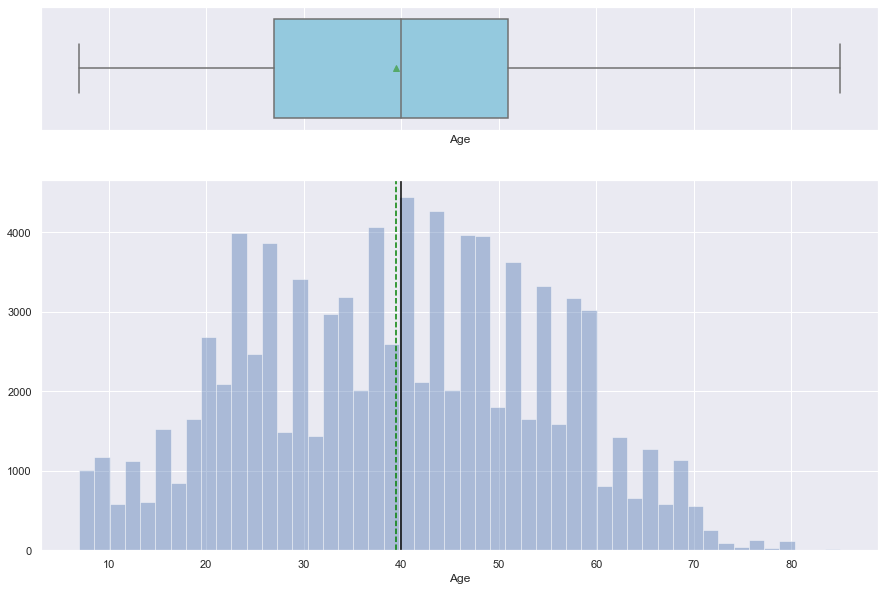

In [31]:
histogram_boxplot(df['Age'])

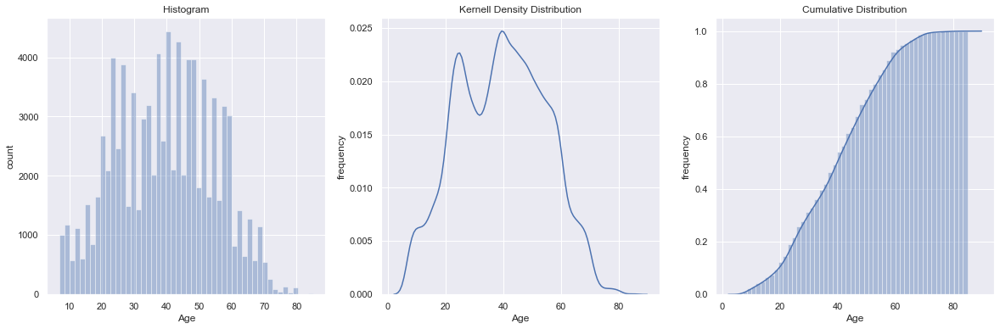

In [32]:
quant_var_graphs('Age')

**Observations**
* Age is a Discrete Quantitative Variable
* The average customer’s Age is 39.44 years
* 75% of customers have an Age lower or equal to 51 years old
* There is no influence of outliers in Age data
* Age data distribution is slightly right skewed

### Flight_Distance

In [33]:
quant_var_stats('Flight_Distance')

Discrete Quantitative Variable

Measures of Central Tendency
Mean:  1981.6294422385251 
Median:  1927.0 
Mode:  0    1639
dtype: int64

Measures of Location
Min:  50 
Max:  6950 
Lower Whisker: -413.0 
1st Quartile:  1360.0 
3rd Quartile:  2542.0 
Upper Whisker: 4315.0

Measures of Variability
Range:  6900 
IQR:  1182.0 
STD:  1026.7799320072593


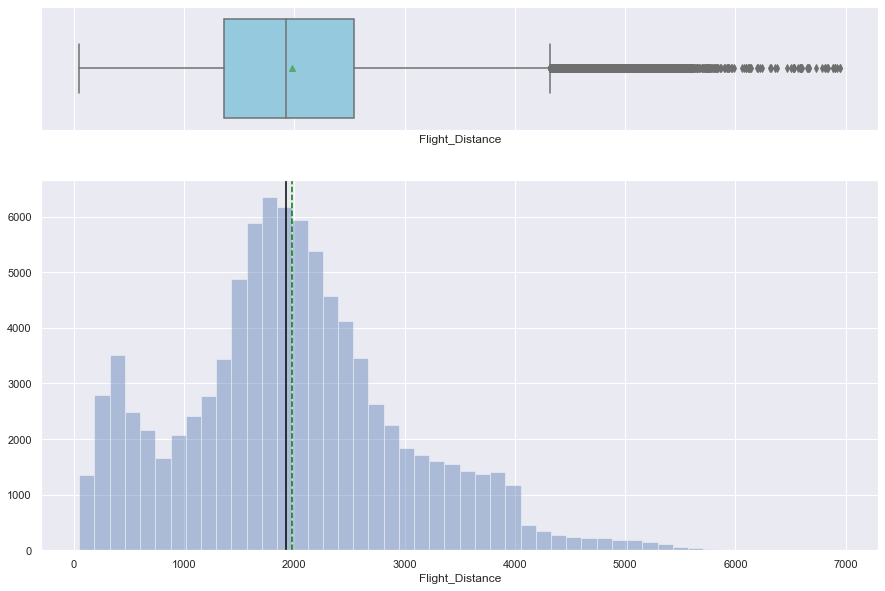

In [34]:
histogram_boxplot(df["Flight_Distance"])

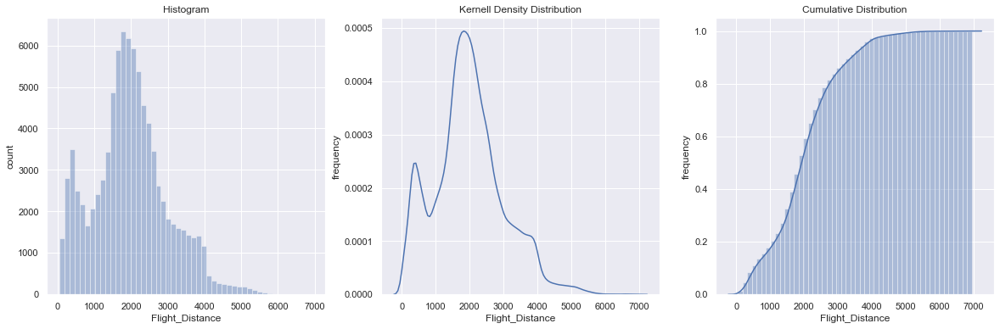

In [35]:
quant_var_graphs('Flight_Distance')

**Observations**
* Discrete Quantitative Variable
* The average flight distance is 1,981.62 miles
* 75% of customers flight 2,542 miles or less
* Data higher than 4,315 miles must be considered outlier
* Data distribution is right skewed

### DepartureDelayin_Mins

In [36]:
quant_var_stats('DepartureDelayin_Mins')

Discrete Quantitative Variable

Measures of Central Tendency
Mean:  14.686593266385824 
Median:  0.0 
Mode:  0    0
dtype: int64

Measures of Location
Min:  0 
Max:  1592 
Lower Whisker: -18.0 
1st Quartile:  0.0 
3rd Quartile:  12.0 
Upper Whisker: 30.0

Measures of Variability
Range:  1592 
IQR:  12.0 
STD:  38.669259728974936


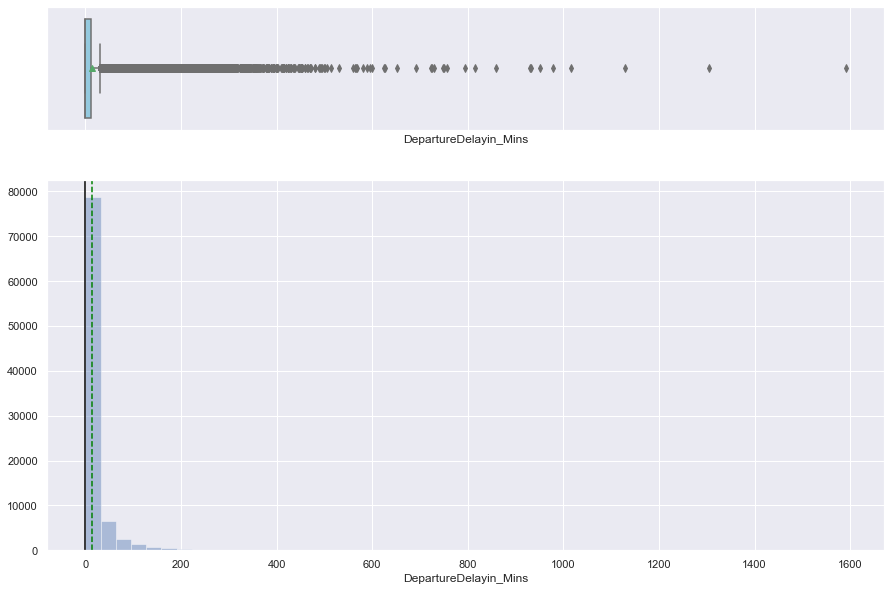

In [37]:
histogram_boxplot(df["DepartureDelayin_Mins"])

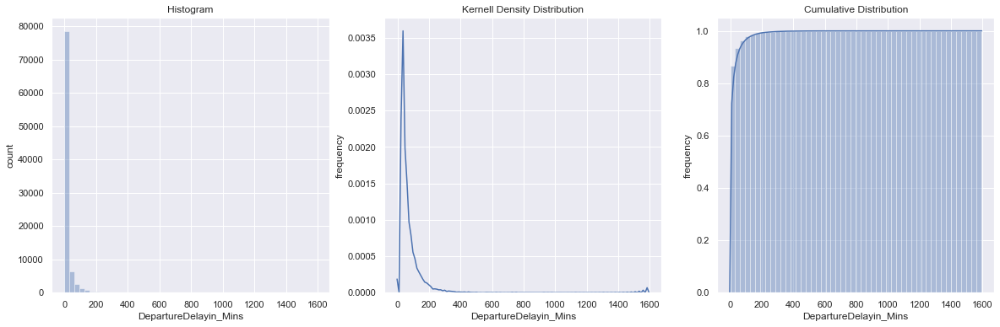

In [38]:
quant_var_graphs('DepartureDelayin_Mins')

**Observations**
* Discrete Quantitative Variable
* The average departure delay is 14.68 minutes
* 75% of customers experiences a delay of 12 minutes
* Data higher than 30 minutes must be considered outlier
* Data distribution is right skewed

### ArrivalDelayin_Mins

In [39]:
quant_var_stats('ArrivalDelayin_Mins')

Continuous Quantitative Variable

Measures of Central Tendency
Mean:  15.011889965572996 
Median:  0.0 
Mode:  0    0.0
dtype: float64

Measures of Location
Min:  0.0 
Max:  1584.0 
Lower Whisker: -19.5 
1st Quartile:  0.0 
3rd Quartile:  13.0 
Upper Whisker: 32.5

Measures of Variability
Range:  1584.0 
IQR:  13.0 
STD:  38.9865589823149


### ArrivalDelayin_Mins

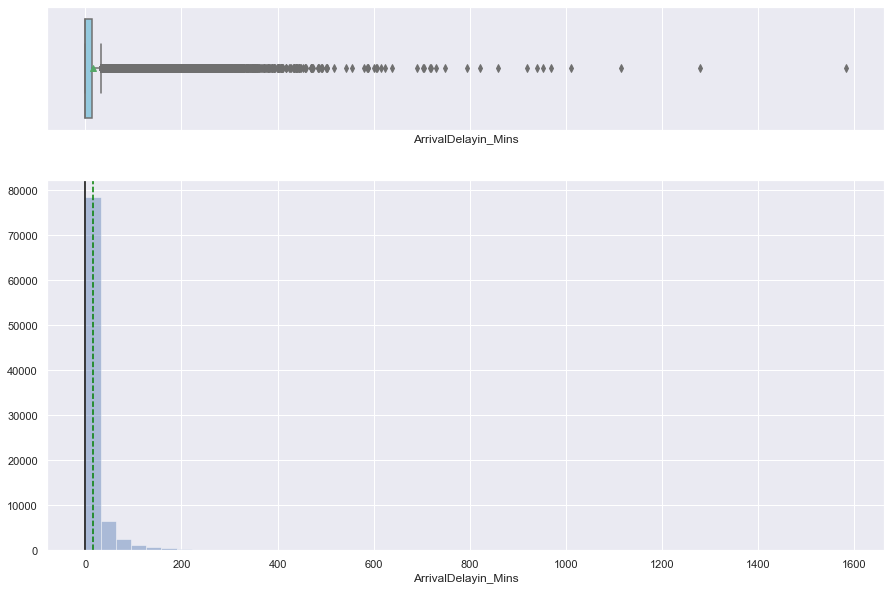

In [40]:
histogram_boxplot(df["ArrivalDelayin_Mins"])

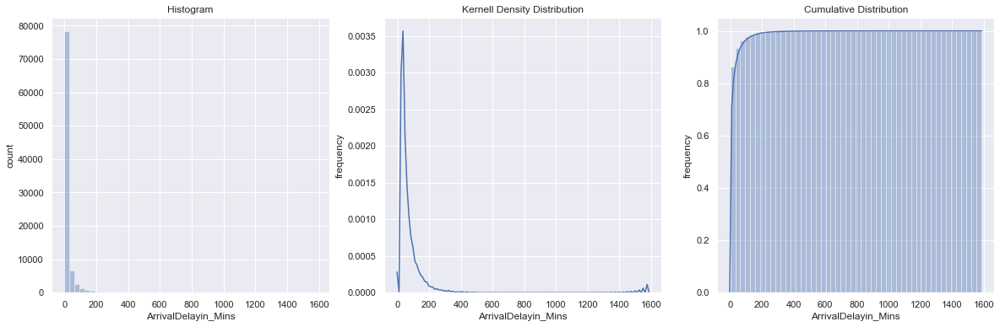

In [41]:
quant_var_graphs('ArrivalDelayin_Mins')

**Observations**
* Continuous Quantitative Variable
* The average arrival delay is 15.01 minutes
* 75% of customers experiences a delay of 13 minutes
* Data higher than 32.5 minutes must be considered outlier
* Data distribution is right skewed

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Univariate Analysis - Summary of Quantitative Variables (Histograms)

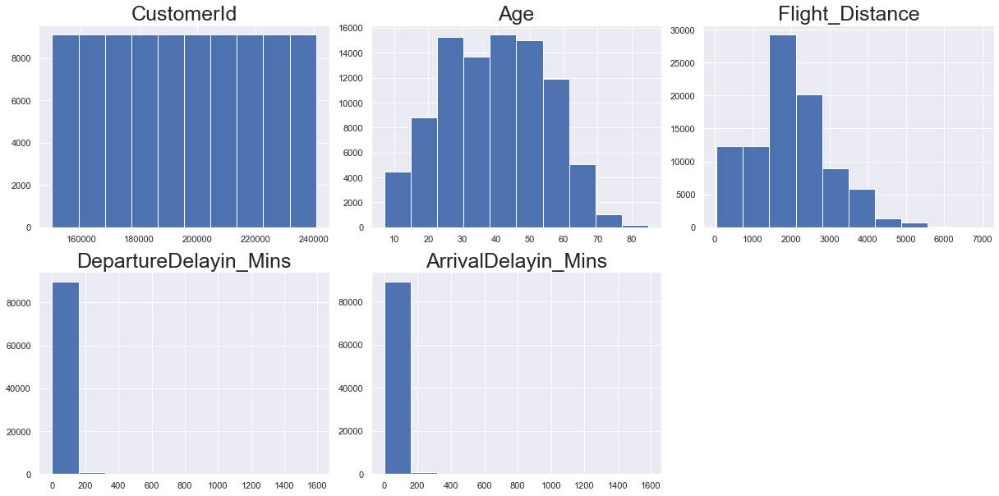

In [42]:
# lets plot histogram of all plots
from scipy.stats import norm
all_col = data.select_dtypes(include=np.number).columns.tolist()
plt.figure(figsize=(17,75))

for i in range(len(all_col)):
    plt.subplot(18,3,i+1)
    plt.hist(data[all_col[i]])
    #sns.displot(df[all_col[i]], kde=True)
    plt.tight_layout()
    plt.title(all_col[i],fontsize=25)
    

plt.show()

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Univariate Analysis - Categorical Variables

In [43]:
def perc_on_bar(feature):
    '''
    plot
    feature: categorical feature
    the function won't work if a column is passed in hue parameter
    '''
    #Creating a countplot for the feature
    sns.set(rc={'figure.figsize':(15,7)})
    ax=sns.countplot(x=feature, data=data)
    
    total = len(feature) # length of the column
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height()/total) # percentage of each class of the category
        x = p.get_x() + p.get_width() / 2 - 0.1 # width of the plot
        y = p.get_y() + p.get_height()           # hieght of the plot
        ax.annotate(percentage, (x, y), size = 14) # annotate the percantage 
        
    plt.show() # show the plot

### Satisfaction

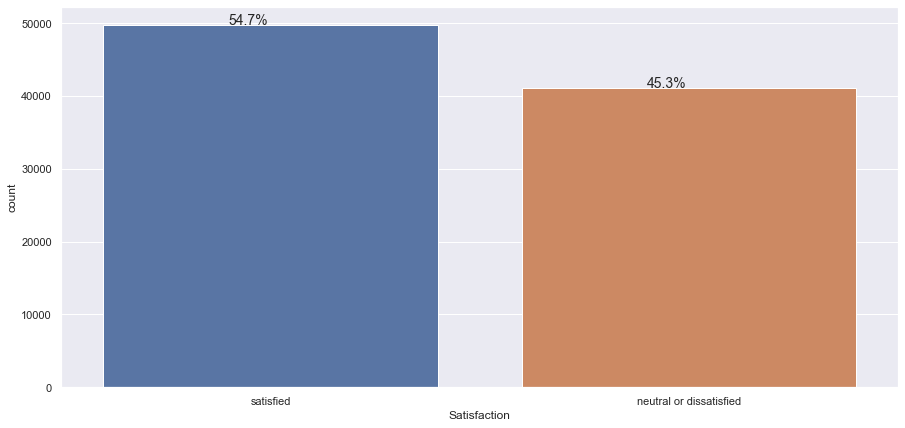

In [44]:
perc_on_bar(data['Satisfaction'])

### Seat_comfort

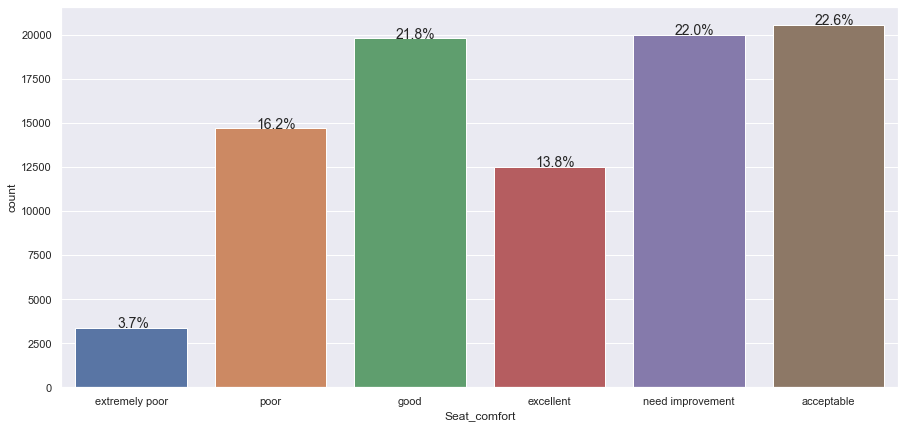

In [45]:
perc_on_bar(data['Seat_comfort'])

### DepartureArrivaltime_convenient

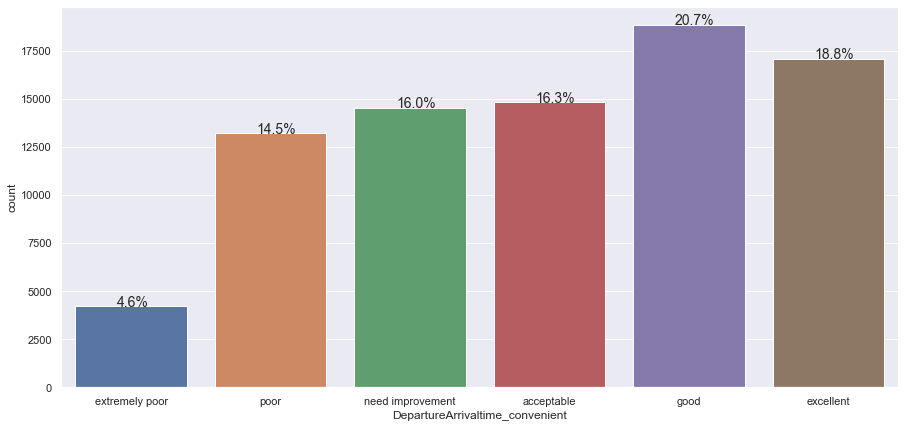

In [46]:
perc_on_bar(data['DepartureArrivaltime_convenient'])

### Food_drink

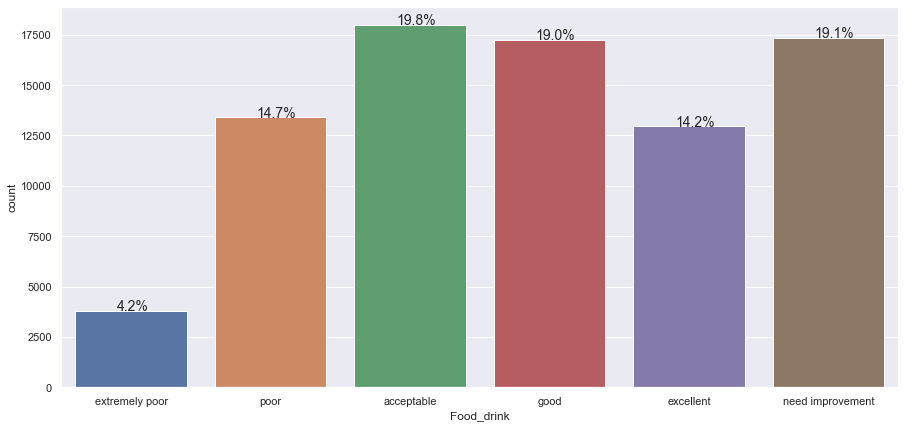

In [47]:
perc_on_bar(data['Food_drink'])

### Gate_location

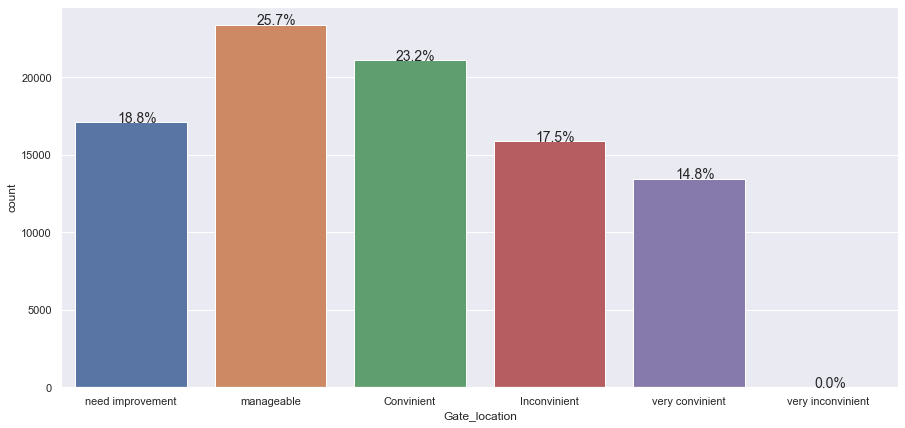

In [48]:
perc_on_bar(data['Gate_location'])

### Inflightwifi_service

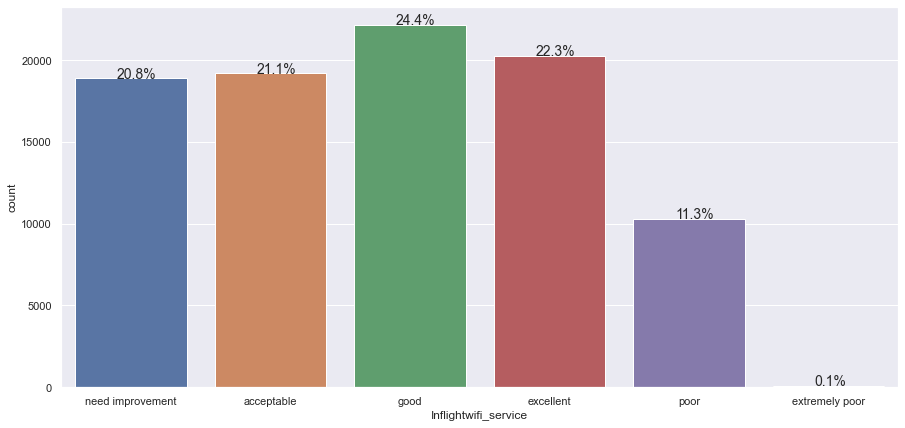

In [49]:
perc_on_bar(data['Inflightwifi_service'])

### Inflight_entertainment

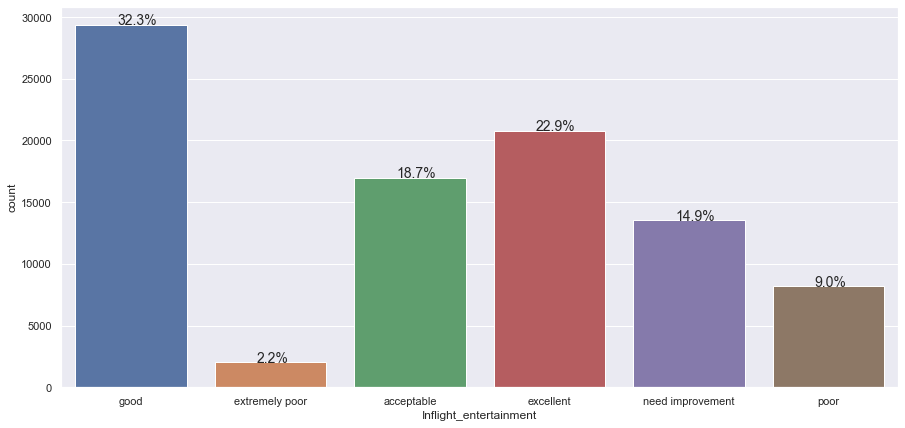

In [50]:
perc_on_bar(data['Inflight_entertainment'])

### Online_support

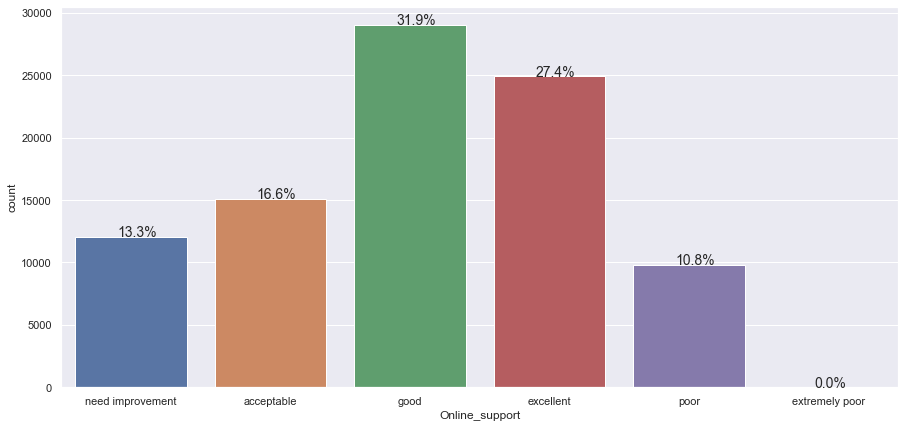

In [51]:
perc_on_bar(data['Online_support'])

### Ease_of_Onlinebooking

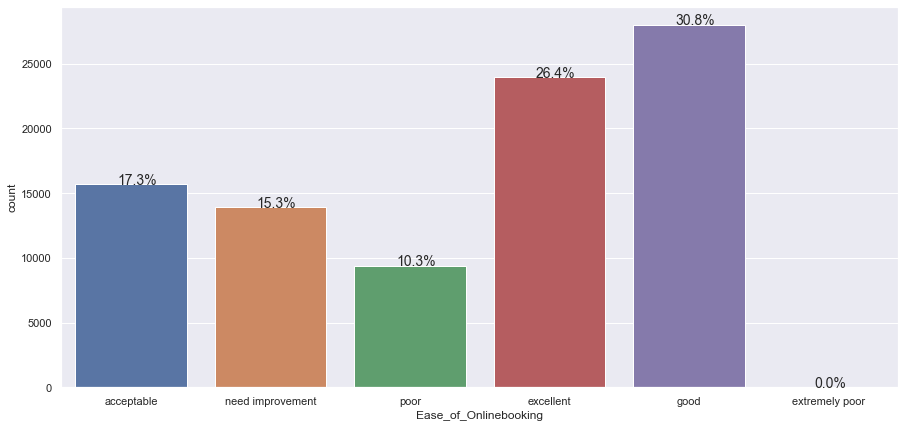

In [52]:
perc_on_bar(data['Ease_of_Onlinebooking'])

### Onboard_service

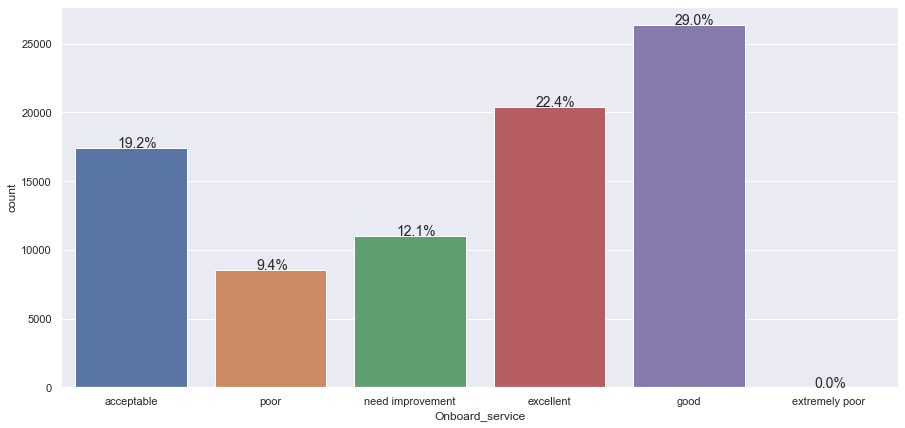

In [53]:
perc_on_bar(data['Onboard_service'])

### Leg_room_service

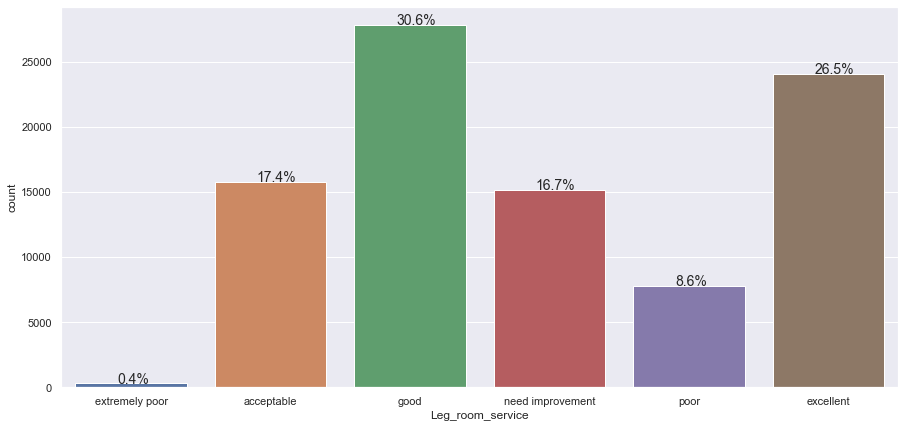

In [54]:
perc_on_bar(data['Leg_room_service'])

### Baggage_handling

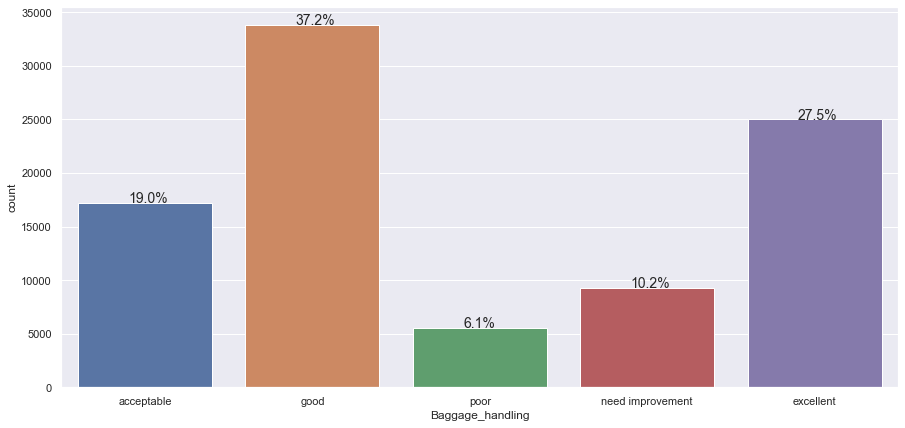

In [55]:
perc_on_bar(data['Baggage_handling'])

### Checkin_service

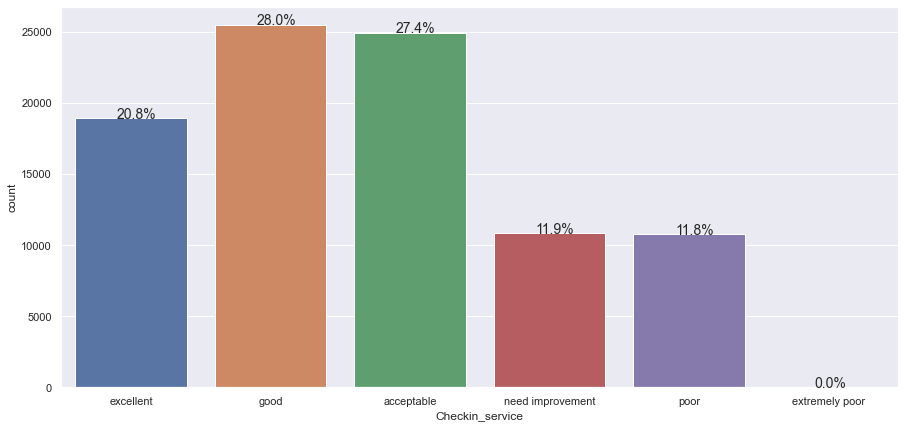

In [56]:
perc_on_bar(data['Checkin_service'])

### Cleanliness

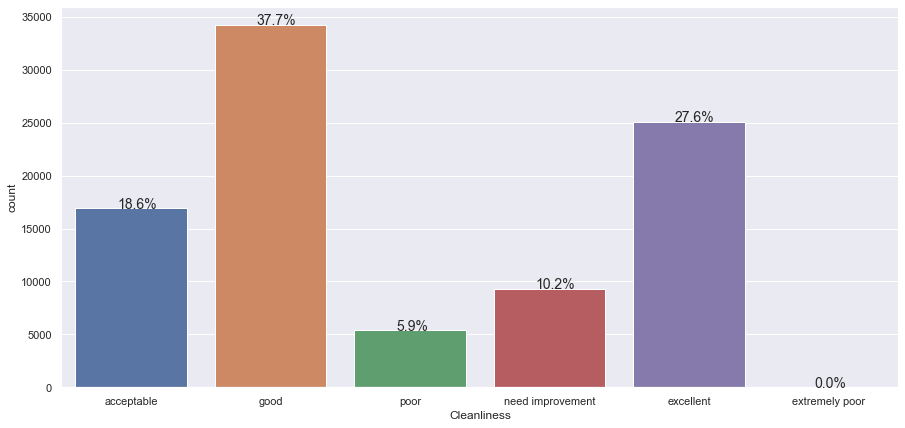

In [57]:
perc_on_bar(data['Cleanliness'])

### Online_boarding

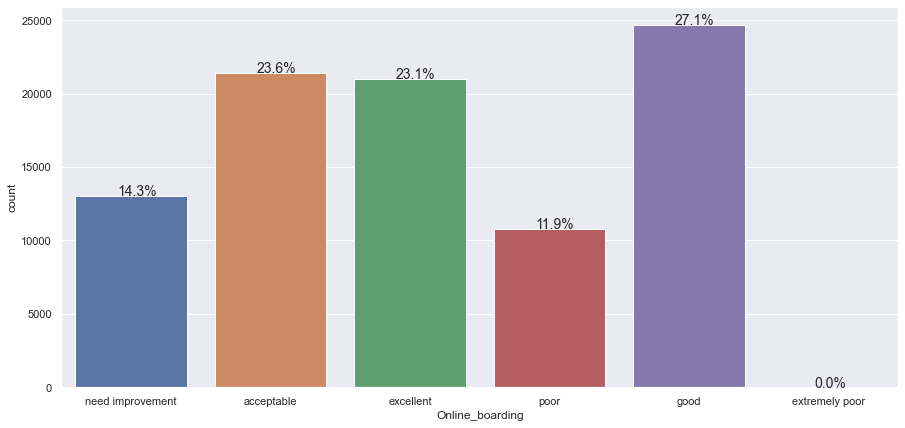

In [58]:
perc_on_bar(data['Online_boarding'])

### Gender

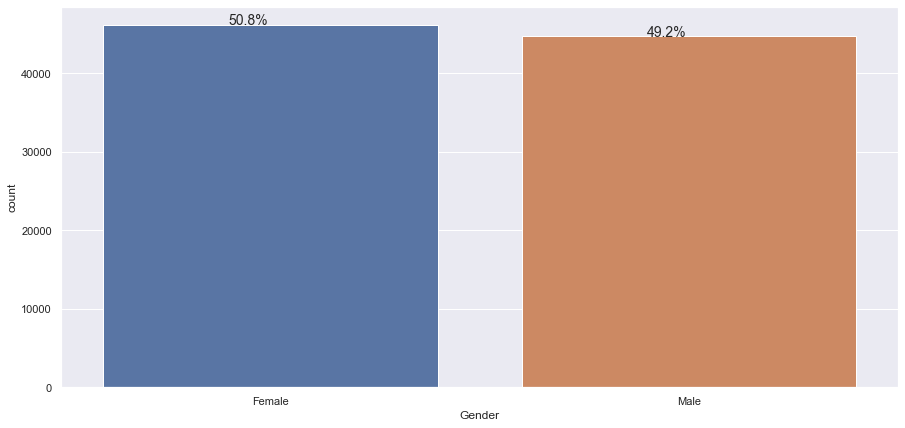

In [59]:
perc_on_bar(data['Gender'])

### CustomerType

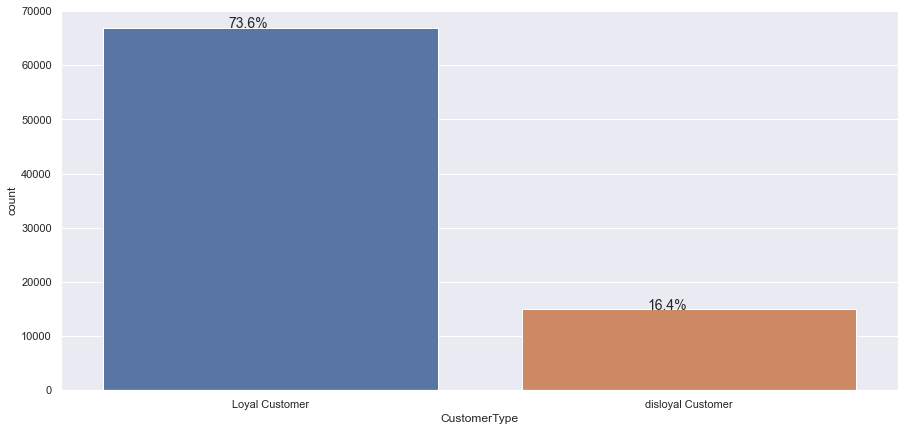

In [60]:
perc_on_bar(data['CustomerType'])

### TypeTravel

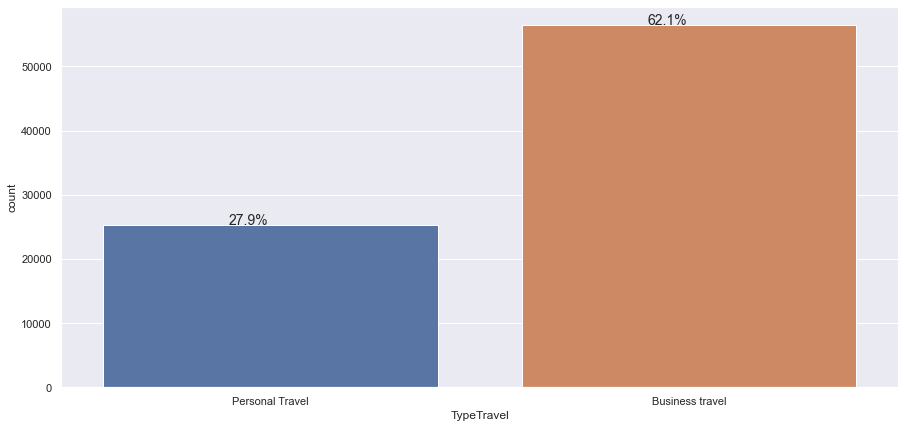

In [61]:
perc_on_bar(data['TypeTravel'])

### Class

Class 
 Business    0.478843
Eco         0.448299
Eco Plus    0.072858
Name: Class, dtype: float64


Text(0, 0.5, 'count')

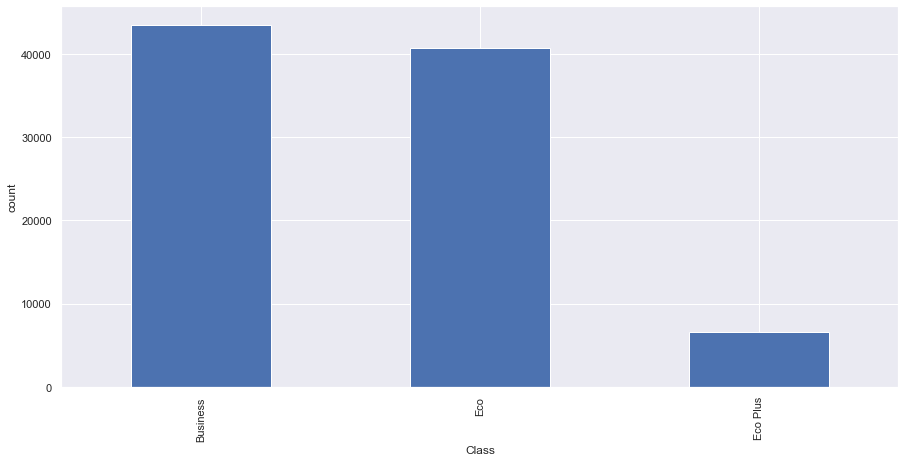

In [62]:
print('Class \n',data['Class'].value_counts(normalize= True))
data['Class'].value_counts().plot(kind='bar')
plt.xlabel('Class')
plt.ylabel('count')

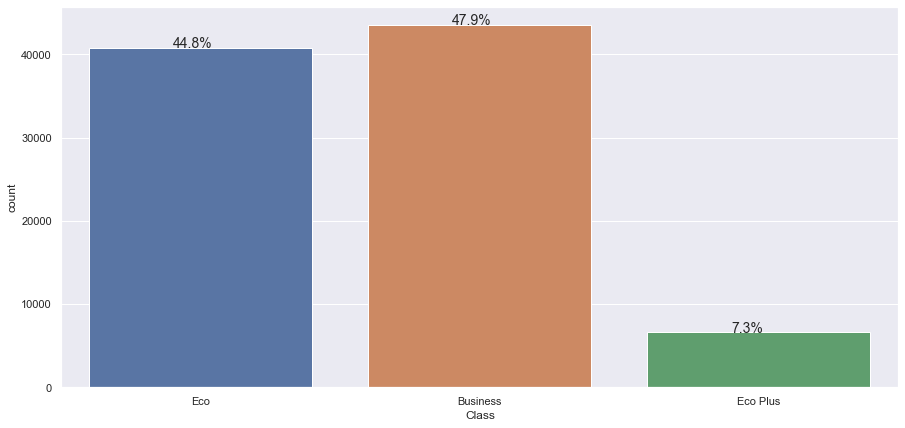

In [63]:
perc_on_bar(data['Class'])

**Observations**
Categorical variables show us that:
* Customers arrived mainly from Self Inquiry (70.82%)
* The main concentration of customers are Salaried or Small Business owners (approx. 90%)
* There is a slightly majority of male customers (59.65%)
* Products Multi and Super Deluxe were the most demanded
* Almost 50% of customers were Married
* Almost 75% of the customers were Executives or Managers

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Bivariate Analysis

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Correlation between Quantitative Variables:

In [64]:
# Check for correlation among quantitative variables
correlation = df.corr() # creating a 2-D Matrix with correlation plots
correlation

,CustomerId,Satisfaction,Seat_comfort,DepartureArrivaltime_convenient,Food_drink,Gate_location,Inflightwifi_service,Inflight_entertainment,Online_support,Ease_of_Onlinebooking,...,Cleanliness,Online_boarding,Gender,CustomerType,Age,TypeTravel,Class,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins
CustomerId,1.000000,0.378074,0.197475,-0.043608,0.151324,0.013733,0.144398,0.362066,0.231364,0.303009,...,0.122166,0.171615,-0.006037,0.147963,0.179736,0.736776,0.594145,0.107001,-0.008839,-0.009808
Satisfaction,0.378074,1.000000,0.241193,-0.014427,0.112521,-0.012126,0.226197,0.522357,0.387381,0.430126,...,0.258829,0.335134,0.211115,0.274238,0.117450,0.103366,0.307950,-0.039873,-0.073062,-0.078638
Seat_comfort,0.197475,0.241193,1.000000,0.414298,0.685843,0.407987,0.129633,0.423241,0.122006,0.210389,...,0.109346,0.130915,0.072144,0.037594,0.010227,-0.016164,-0.029060,-0.046013,-0.021818,-0.023711
DepartureArrivaltime_convenient,-0.043608,-0.014427,0.414298,1.000000,0.474352,0.520490,-0.004827,0.073330,0.002068,0.000449,...,0.061461,0.000307,-0.046962,0.163373,0.039359,-0.169908,-0.052891,-0.000750,0.005120,0.002900
Food_drink,0.151324,0.112521,0.685843,0.474352,1.000000,0.501748,0.025233,0.347677,0.030334,0.038575,...,0.031571,0.014701,0.057753,0.040616,0.017380,0.026471,0.047582,-0.007942,-0.012652,-0.014432
Gate_location,0.013733,-0.012126,0.407987,0.520490,0.501748,1.000000,-0.004030,0.000462,0.003657,0.000520,...,-0.002349,-0.002224,0.011893,-0.000002,-0.000444,0.011100,-0.006356,-0.003275,0.006343,0.006179
Inflightwifi_service,0.144398,0.226197,0.129633,-0.004827,0.025233,-0.004030,1.000000,0.251355,0.557419,0.602718,...,0.039227,0.630631,0.030374,0.067836,0.014362,0.018200,0.063619,0.012162,-0.032645,-0.034711
Inflight_entertainment,0.362066,0.522357,0.423241,0.073330,0.347677,0.000462,0.251355,1.000000,0.442551,0.319445,...,0.108863,0.353676,0.141345,0.215995,0.132323,0.074172,0.243297,-0.028657,-0.029105,-0.031395
Online_support,0.231364,0.387381,0.122006,0.002068,0.030334,0.003657,0.557419,0.442551,1.000000,0.617208,...,0.095775,0.670567,0.089689,0.171713,0.120716,0.033798,0.177869,-0.030503,-0.033208,-0.034829
Ease_of_Onlinebooking,0.303009,0.430126,0.210389,0.000449,0.038575,0.000520,0.602718,0.319445,0.617208,1.000000,...,0.417755,0.684488,0.082302,0.138475,0.074240,0.024550,0.129677,-0.024291,-0.035845,-0.038850


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Correlation Heatmap for Quantitative Variables:

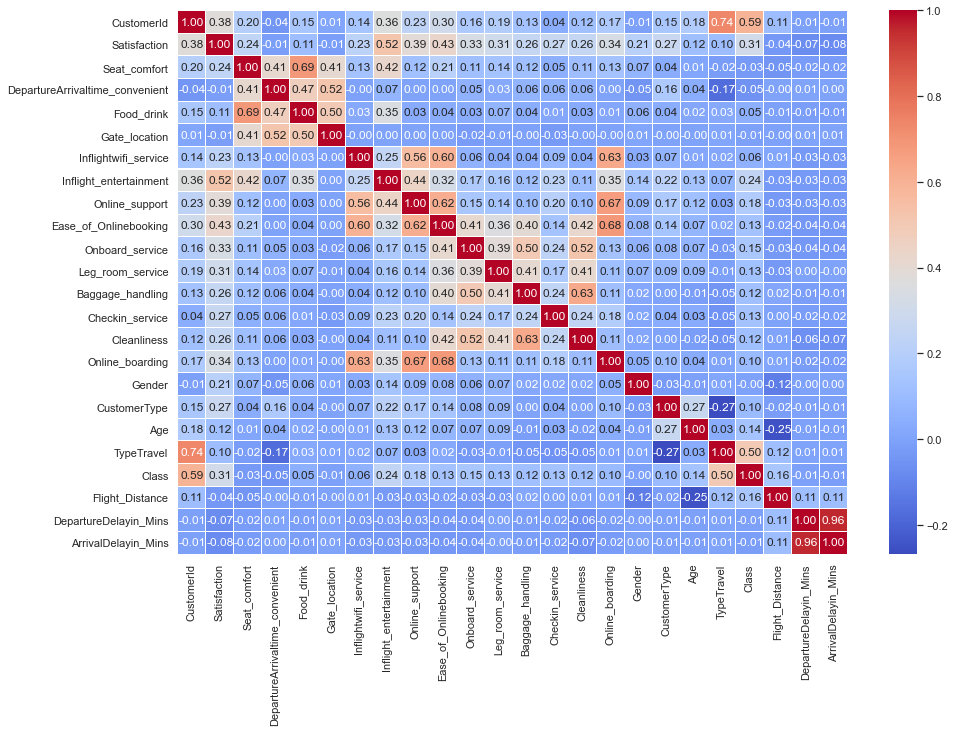

In [65]:
# Heatmap for Correlation
fig,ax = plt.subplots(figsize=(15, 10))   
sns.heatmap(df.corr(), ax=ax, annot=True, linewidths=0.05, fmt= '.2f',cmap="coolwarm") # the color intensity is based on 
plt.show()

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Bivariate Scatter Plots:

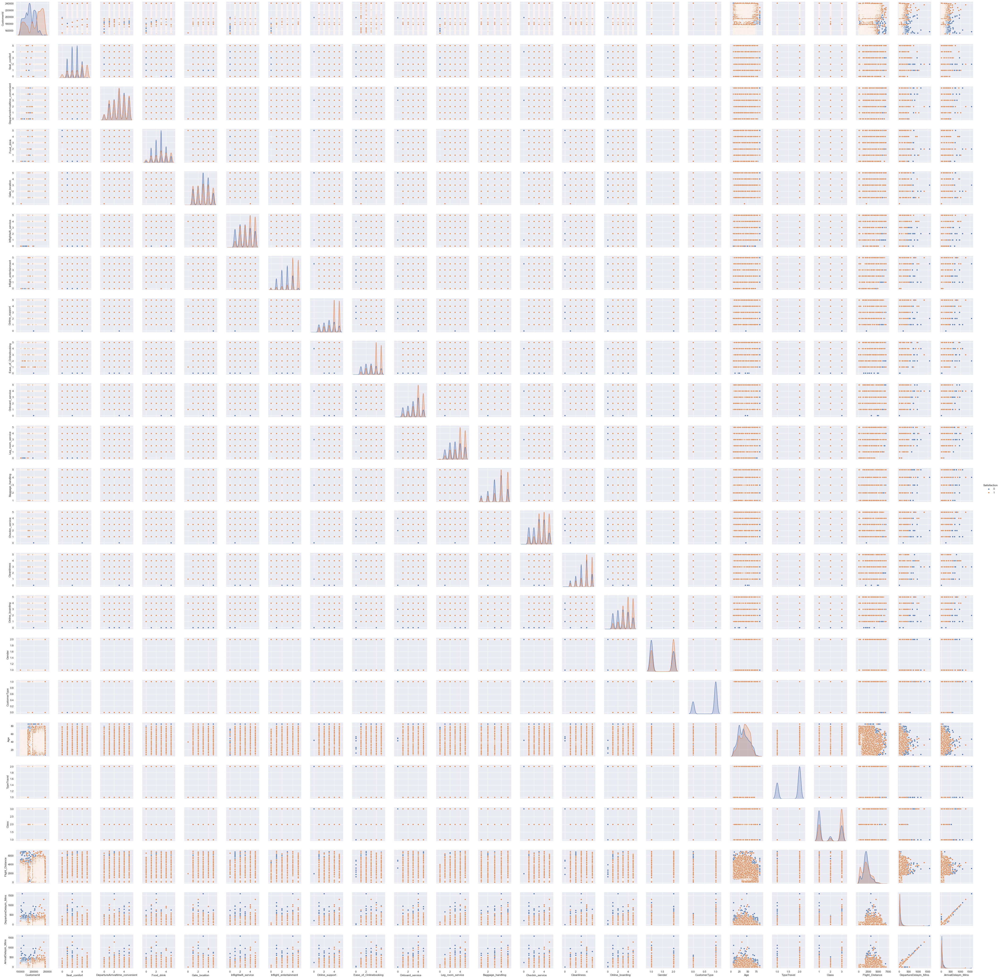

In [66]:
#Check for Bivariate Scatter Plots including Regression Lines
sns.pairplot(data=df, hue='Satisfaction')

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Satisfaction vs. Relevant Variables

In [67]:
### Function to plot stacked bar charts for categorical columns
def stacked_plot(x,flag=True):
    sns.set(palette='nipy_spectral')
    tab1 = pd.crosstab(x,data['Satisfaction'],margins=True)
    if flag==True:
        print(tab1)
        print('-'*120)
    tab = pd.crosstab(x,df['Satisfaction'],normalize='index')
    tab.plot(kind='bar',stacked=True,figsize=(10,5))
    plt.legend(loc='lower left', frameon=False)
    plt.legend(loc="upper left", bbox_to_anchor=(1,1))
    plt.show()

### Satisfaction vs. Inflight_entertainment

Satisfaction            neutral or dissatisfied  satisfied    All
Inflight_entertainment                                           
0                                           678       1360   2038
1                                          6459       1739   8198
2                                         11181       2346  13527
3                                         13641       3354  16995
4                                          8186      21187  29373
5                                          1011      19775  20786
All                                       41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


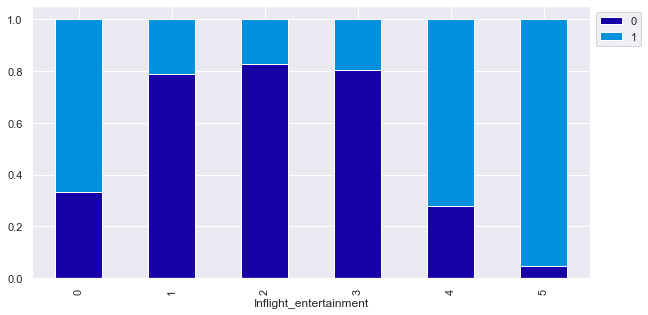

In [68]:
stacked_plot(df.Inflight_entertainment)

### Satisfaction vs. Ease_of_Onlinebooking

Satisfaction           neutral or dissatisfied  satisfied    All
Ease_of_Onlinebooking                                           
0                                           12          0     12
1                                         7560       1810   9370
2                                         9944       3952  13896
3                                        10067       5619  15686
4                                         7867      20126  27993
5                                         5706      18254  23960
All                                      41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


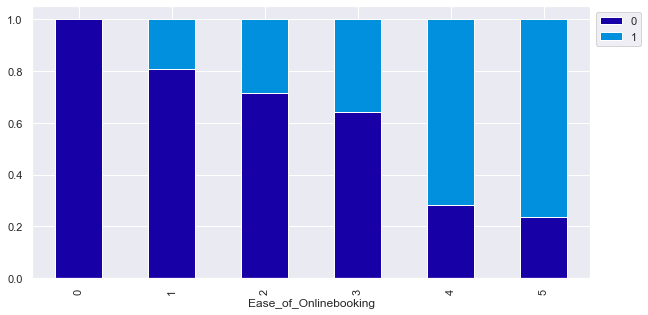

In [69]:
stacked_plot(df.Ease_of_Onlinebooking)

### Satisfaction vs. Class

Satisfaction  neutral or dissatisfied  satisfied    All
Class                                                  
1                               24755      16003  40758
2                                3801       2823   6624
3                               12600      30935  43535
All                             41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


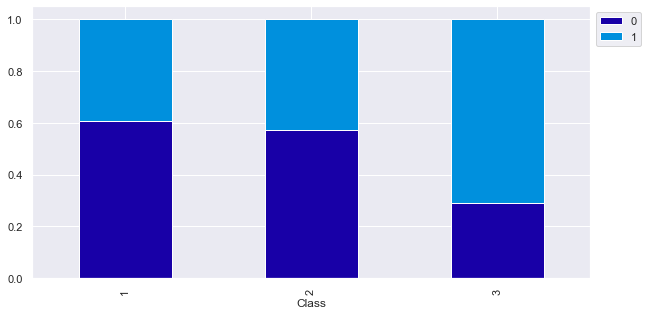

In [70]:
stacked_plot(df.Class)

### Satisfaction vs. Seat_comfort

Satisfaction  neutral or dissatisfied  satisfied    All
Seat_comfort                                           
0                                   6       3362   3368
1                                7997       6690  14687
2                               12904       7098  20002
3                               13274       7278  20552
4                                6878      12911  19789
5                                  97      12422  12519
All                             41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


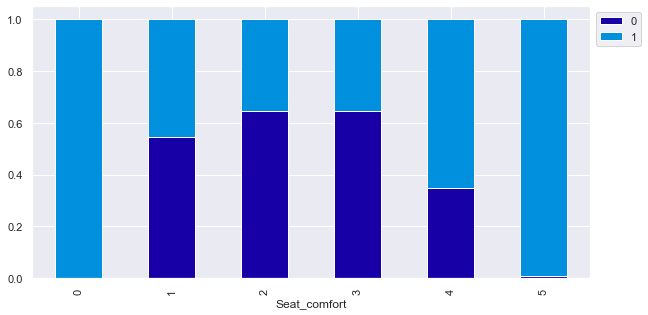

In [71]:
stacked_plot(df.Seat_comfort)

### Satisfaction vs. DepartureArrivaltime_convenient

Satisfaction                     neutral or dissatisfied  satisfied    All
DepartureArrivaltime_convenient                                           
0.0                                                 1933       2266   4199
1.0                                                 5391       7819  13210
2.0                                                 6789       7750  14539
3.0                                                10528      12522  23050
4.0                                                 8963       9877  18840
5.0                                                 7552       9527  17079
All                                                41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


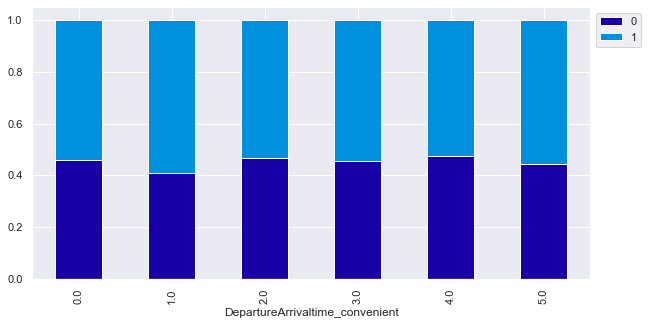

In [72]:
stacked_plot(df.DepartureArrivaltime_convenient)

### Satisfaction vs. Food_drink

Satisfaction  neutral or dissatisfied  satisfied    All
Food_drink                                             
0.0                               825       2969   3794
1.0                              6521       6879  13400
2.0                              9903       7456  17359
3.0                             13965      12207  26172
4.0                              7091      10154  17245
5.0                              2851      10096  12947
All                             41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


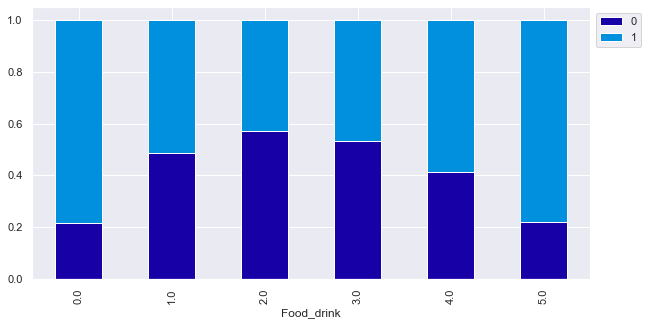

In [73]:
stacked_plot(df.Food_drink)

### Satisfaction vs. Gate_location

Satisfaction   neutral or dissatisfied  satisfied    All
Gate_location                                           
0                                    0          1      1
1                                 6133       9743  15876
2                                 7222       9891  17113
3                                12585      10800  23385
4                                10621      10467  21088
5                                 4595       8859  13454
All                              41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


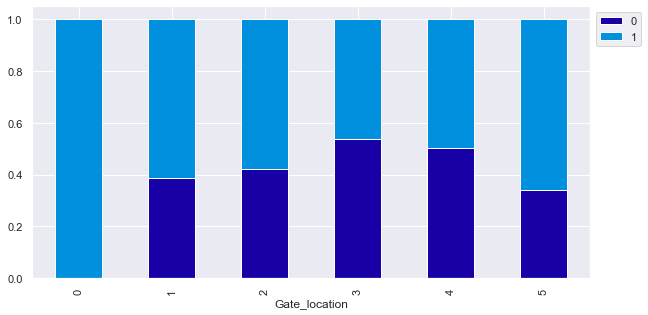

In [74]:
stacked_plot(df.Gate_location)

### Satisfaction vs. Inflightwifi_service

Satisfaction          neutral or dissatisfied  satisfied    All
Inflightwifi_service                                           
0                                          53         43     96
1                                        7527       2784  10311
2                                        9447       9447  18894
3                                        9382       9817  19199
4                                        7994      14165  22159
5                                        6753      13505  20258
All                                     41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


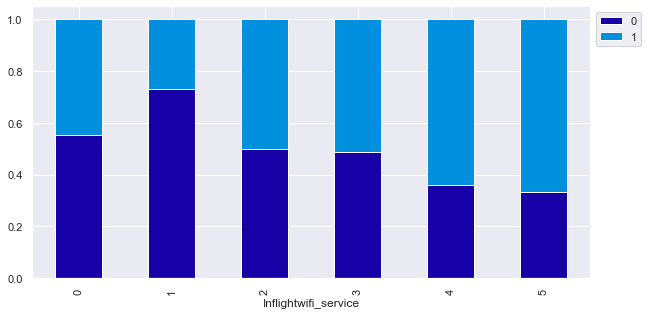

In [75]:
stacked_plot(df.Inflightwifi_service)

### Satisfaction vs. Online_support

Satisfaction    neutral or dissatisfied  satisfied    All
Online_support                                           
0                                     1          0      1
1                                  6867       2938   9805
2                                  8501       3562  12063
3                                 10834       4256  15090
4                                  9229      19813  29042
5                                  5724      19192  24916
All                               41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


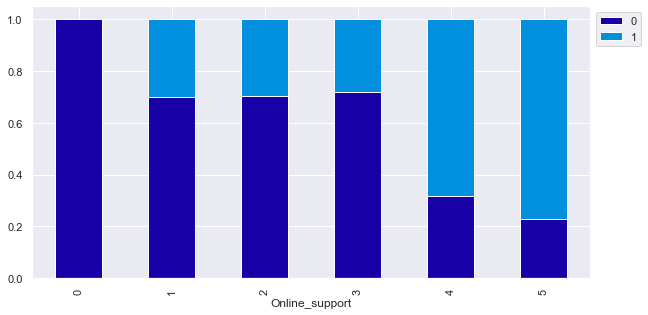

In [76]:
stacked_plot(df.Online_support)

### Satisfaction vs. Onboard_service

Satisfaction     neutral or dissatisfied  satisfied    All
Onboard_service                                           
0.0                                    3          0      3
1.0                                 6236       2301   8537
2.0                                 7271       3747  11018
3.0                                10278       7133  17411
4.0                                12599      20953  33552
5.0                                 4769      15627  20396
All                                41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


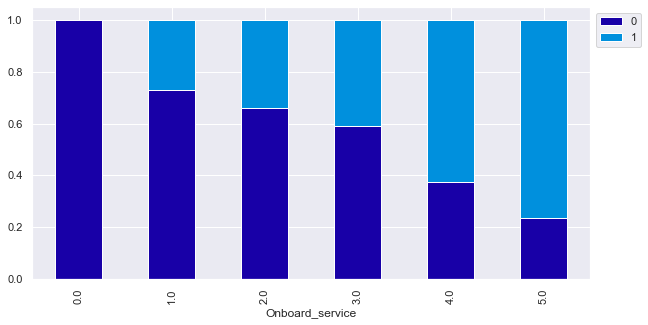

In [77]:
stacked_plot(df.Onboard_service)

### Satisfaction vs. Leg_room_service

Satisfaction      neutral or dissatisfied  satisfied    All
Leg_room_service                                           
0                                     104        218    322
1                                    5556       2223   7779
2                                    9475       5681  15156
3                                    9952       5823  15775
4                                    9051      18763  27814
5                                    7018      17053  24071
All                                 41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


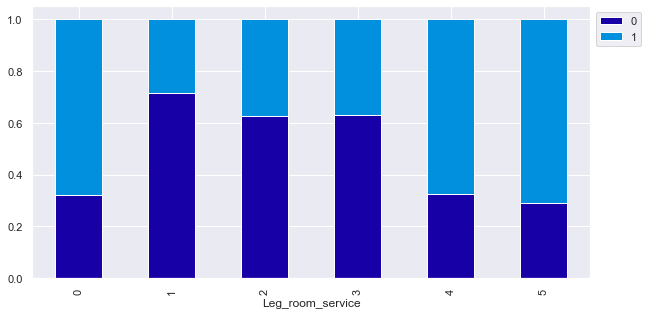

In [78]:
stacked_plot(df.Leg_room_service)

### Satisfaction vs. Baggage_handling

Satisfaction      neutral or dissatisfied  satisfied    All
Baggage_handling                                           
1                                    3202       2357   5559
2                                    5627       3674   9301
3                                   11771       5462  17233
4                                   13927      19895  33822
5                                    6629      18373  25002
All                                 41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


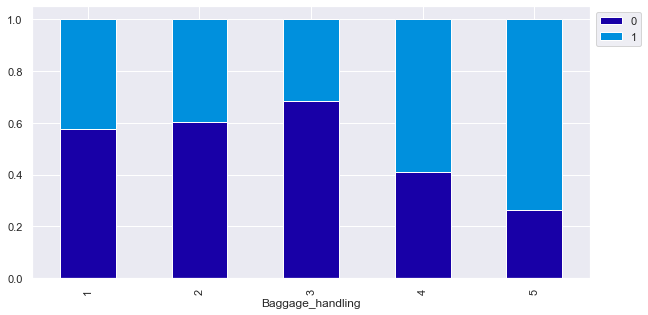

In [79]:
stacked_plot(df.Baggage_handling)

### Satisfaction vs. Checkin_service

Satisfaction     neutral or dissatisfied  satisfied    All
Checkin_service                                           
0                                      1          0      1
1                                   7352       3409  10761
2                                   7238       3575  10813
3                                  10832      14109  24941
4                                  10728      14755  25483
5                                   5005      13913  18918
All                                41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


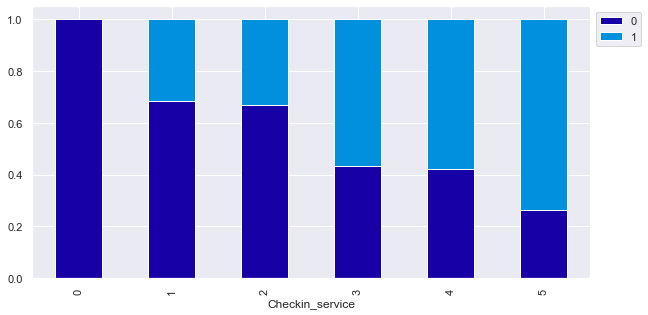

In [80]:
stacked_plot(df.Checkin_service)

### vs. Gender

Satisfaction  neutral or dissatisfied  satisfied    All
Gender                                                 
1                               25025      19706  44731
2                               16131      30055  46186
All                             41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


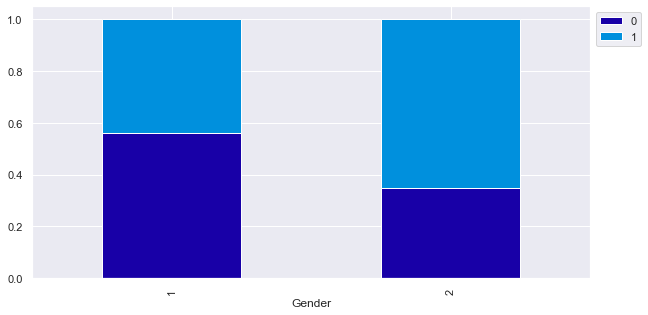

In [81]:
stacked_plot(df.Gender)

### vs. CustomerType

Satisfaction  neutral or dissatisfied  satisfied    All
CustomerType                                           
0.0                             11351       3570  14921
1.0                             29805      46191  75996
All                             41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


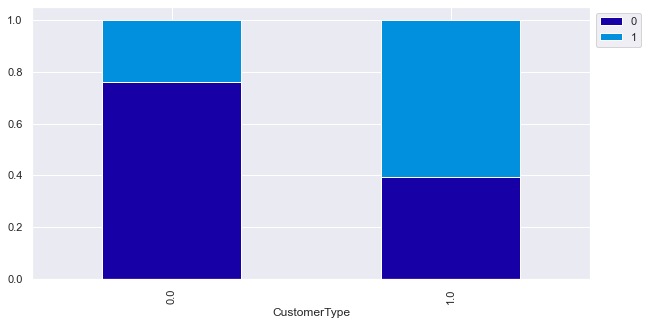

In [82]:
stacked_plot(df.CustomerType)

### vs. TypeTravel

Satisfaction  neutral or dissatisfied  satisfied    All
TypeTravel                                             
1.0                             13572      11776  25348
2.0                             27584      37985  65569
All                             41156      49761  90917
------------------------------------------------------------------------------------------------------------------------


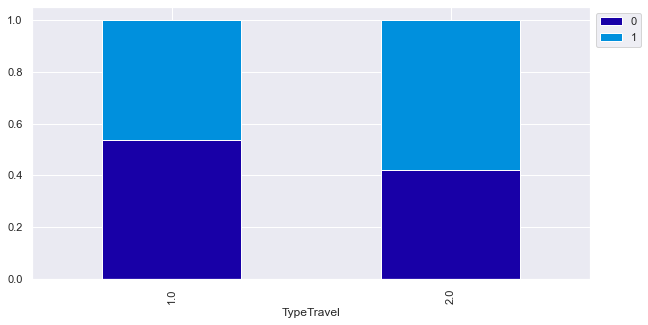

In [83]:
stacked_plot(df.TypeTravel)

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">High-Correlated variables review

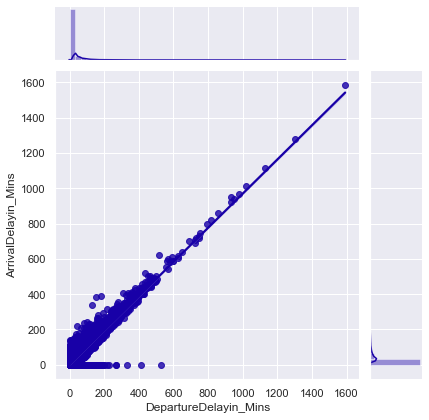

In [84]:
sns.jointplot(df['DepartureDelayin_Mins'], df['ArrivalDelayin_Mins'],kind="reg"); 

#### Observation
* These pair of variables are highly correlated (0.96)
* Since these variables describe delays, we will use only one of them for the analysis
* A departure delay directly implies an arrival delay

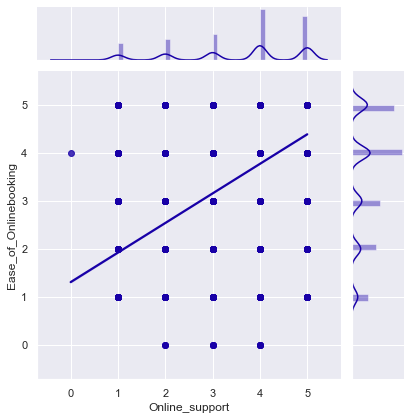

In [99]:
sns.jointplot(df['Online_support'], df['Ease_of_Onlinebooking'],kind="reg"); 

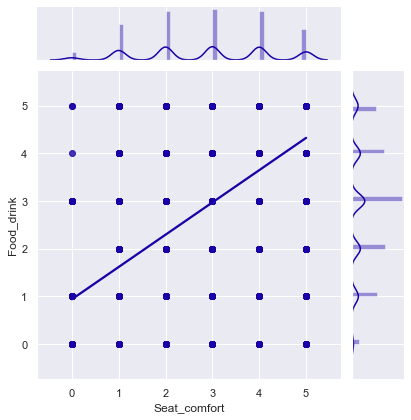

In [85]:
sns.jointplot(df['Seat_comfort'], df['Food_drink'],kind="reg"); 

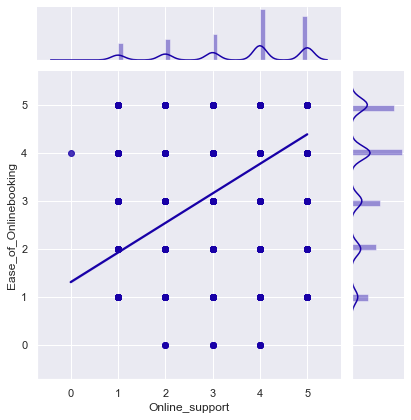

In [86]:
sns.jointplot(df['Online_support'], df['Ease_of_Onlinebooking'],kind="reg"); 

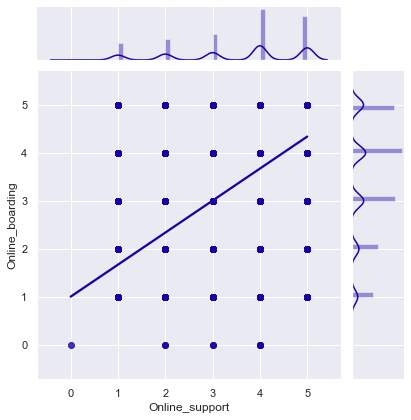

In [87]:
sns.jointplot(df['Online_support'], df['Online_boarding'],kind="reg"); 

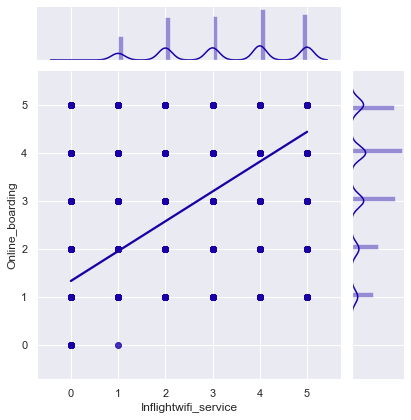

In [88]:
sns.jointplot(df['Inflightwifi_service'], df['Online_boarding'],kind="reg"); 

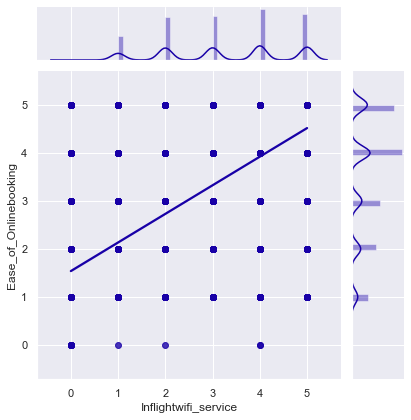

In [89]:
sns.jointplot(df['Inflightwifi_service'], df['Ease_of_Onlinebooking'],kind="reg"); 

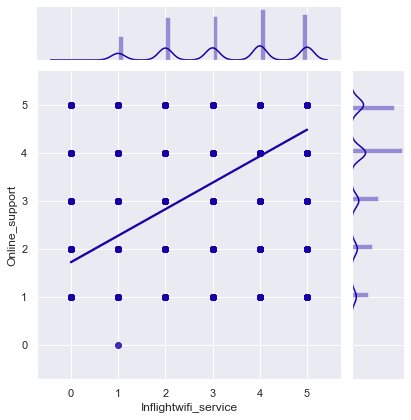

In [90]:
sns.jointplot(df['Inflightwifi_service'], df['Online_support'],kind="reg"); 

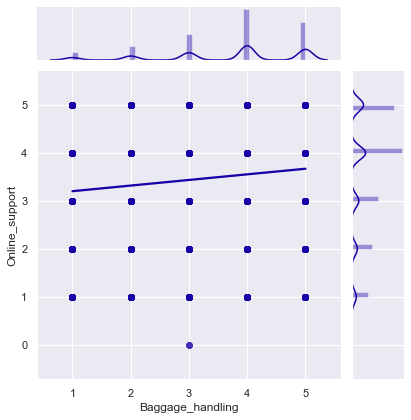

In [91]:
sns.jointplot(df['Baggage_handling'], df['Online_support'],kind="reg"); 

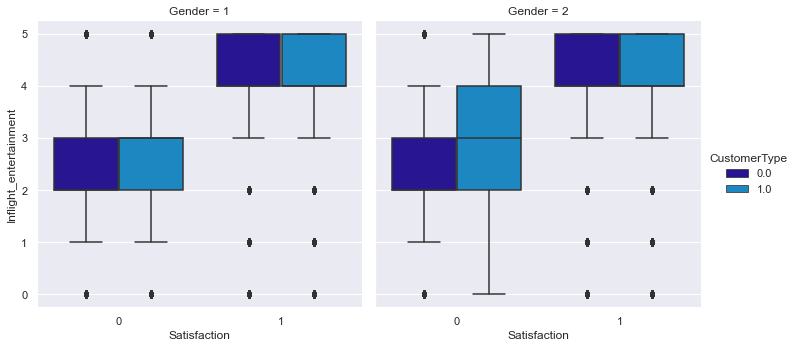

In [90]:
#Evaluating Satisfaction vs. Inflight_entertainment vs. Gender
sns.catplot(x="Satisfaction",
               y = "Inflight_entertainment",
               hue="CustomerType", 
               col="Gender", 
               data=df, 
               kind="box");

# Satisfaction: 0:Neutral or Dissatisfied; 1:Satisfied
# Gender: 1:Male; 2:Female
# CustomerType: 0:Disloyal Customer; 1:Loyal Customer
# Class: 1:Economy; 2:Eco Plus; 3:Business

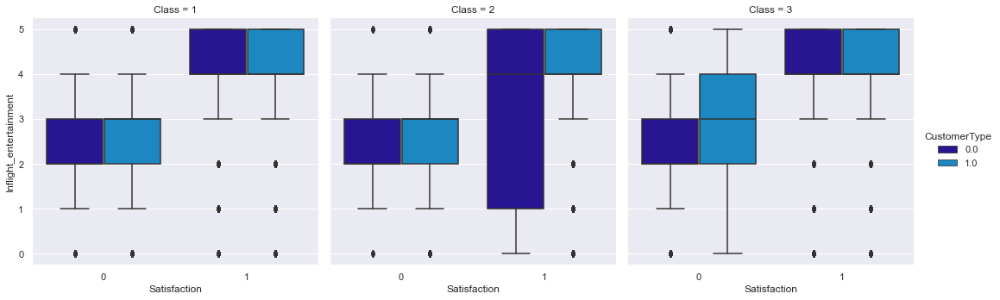

In [91]:
#Evaluating Satisfaction vs. Inflight_entertainment vs. Class
sns.catplot(x="Satisfaction",
               y = "Inflight_entertainment",
               hue="CustomerType", 
               col="Class", 
               data=df, 
               kind="box");

# Satisfaction: 0:Neutral or Dissatisfied; 1:Satisfied
# Gender: 1:Male; 2:Female
# CustomerType: 0:Disloyal Customer; 1:Loyal Customer
# Class: 1:Economy; 2:Eco Plus; 3:Business

#### Observations
- Loyal Customers of any Gender, consider the Inflight Entertainment as good or excellent.  However, the disloyal customers (the potential market to penetrate), consider inflight entertainment as mediocre, especially the male public. Since these variables have a high impact on the Overall Satisfaction rates, it is important to develop  a strategy to improve the inflight activities (movies, TV shows, music, free library, etc.)
- It is very interesting to find the exactly same pattern within the satisfaction of the most representative Passenger Class (47.9% of existing customers) : Business. Dissatisfied Loyal customers from Business Class consider Inflight_Entertainment requires improvement

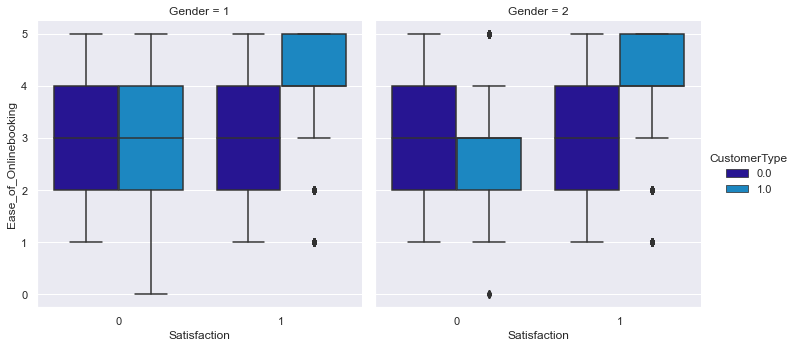

In [92]:
#Evaluating Satisfaction vs. Ease_of_Onlinebooking vs. Gender
sns.catplot(x="Satisfaction",
               y = "Ease_of_Onlinebooking",
               hue="CustomerType", 
               col="Gender", 
               data=df, 
               kind="box");

# Satisfaction: 0:Neutral or Dissatisfied; 1:Satisfied
# Gender: 1:Male; 2:Female
# CustomerType: 0:Disloyal Customer; 1:Loyal Customer
# Class: 1:Economy; 2:Eco Plus; 3:Business

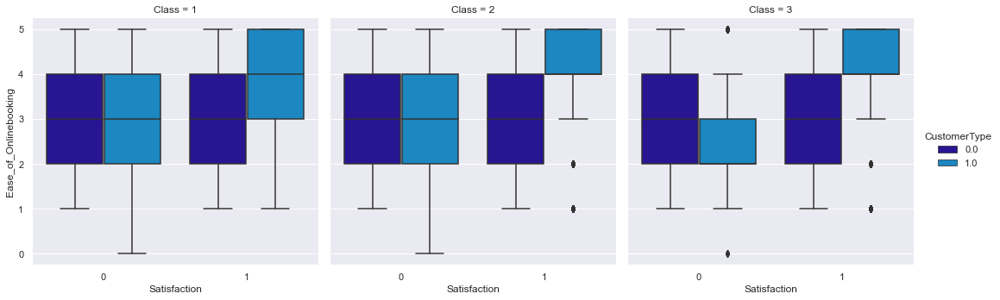

In [95]:
#Evaluating Satisfaction vs. Ease_of_Onlinebooking vs. Class
sns.catplot(x="Satisfaction",
               y = "Ease_of_Onlinebooking",
               hue="CustomerType", 
               col="Class", 
               data=df, 
               kind="box");

# Satisfaction: 0:Neutral or Dissatisfied; 1:Satisfied
# Gender: 1:Male; 2:Female
# CustomerType: 0:Disloyal Customer; 1:Loyal Customer
# Class: 1:Economy; 2:Eco Plus; 3:Business

#### Observations
- Dissatisfied customers, in general, consider the Ease of Online_Booking between acceptable and good.
- 25.6% of the customers considered that Ease_of_Onlinebooking at least needs improvement
- In correlation with the Online_Support variable (0.68), the customers' perception regarding the online services is an improvement area

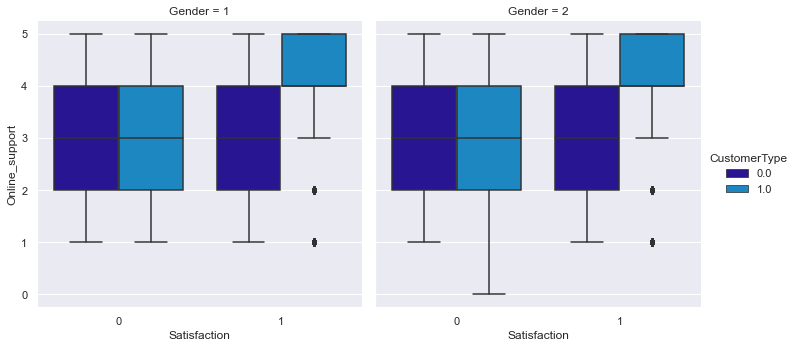

In [94]:
#Evaluating Satisfaction vs. Online_support vs. Gender
sns.catplot(x="Satisfaction",
               y = "Online_support",
               hue="CustomerType", 
               col="Gender", 
               data=df, 
               kind="box");

# Satisfaction: 0:Neutral or Dissatisfied; 1:Satisfied
# Gender: 1:Male; 2:Female
# CustomerType: 0:Disloyal Customer; 1:Loyal Customer
# Class: 1:Economy; 2:Eco Plus; 3:Business

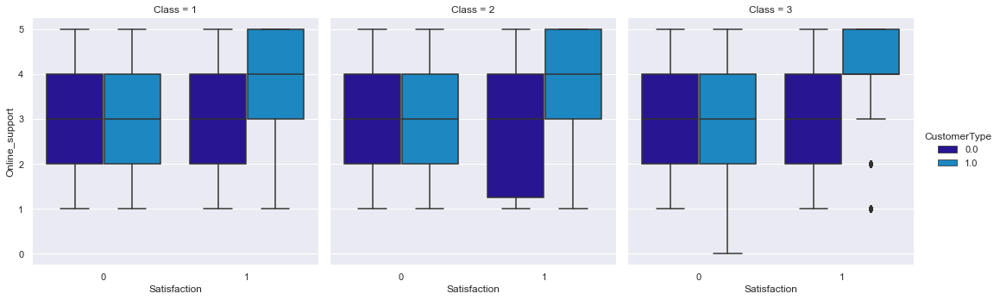

In [98]:
#Evaluating Satisfaction vs. Online_support vs. Class
sns.catplot(x="Satisfaction",
               y = "Online_support",
               hue="CustomerType", 
               col="Class", 
               data=df, 
               kind="box");

# Satisfaction: 0:Neutral or Dissatisfied; 1:Satisfied
# Gender: 1:Male; 2:Female
# CustomerType: 0:Disloyal Customer; 1:Loyal Customer
# Class: 1:Economy; 2:Eco Plus; 3:Business

#### Observations
- In correlation with the Online_Support variable (0.68), the customers' perception regarding the online services is an improvement area
- Dissatisfied customers, in general, consider the Online_Support between acceptable and good

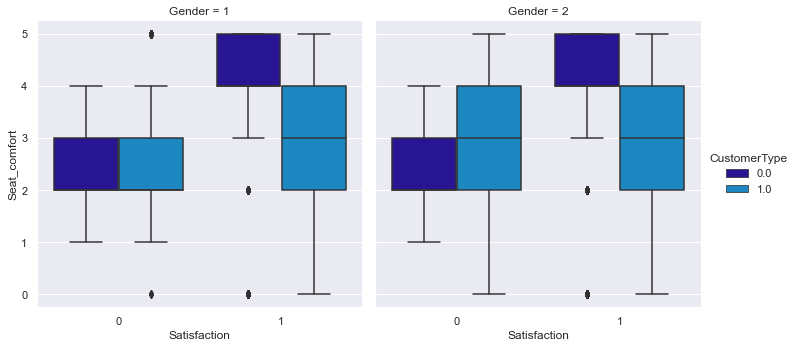

In [93]:
#Evaluating Satisfaction vs. Seat_comfort vs. Gender
sns.catplot(x="Satisfaction",
               y = "Seat_comfort",
               hue="CustomerType", 
               col="Gender", 
               data=df, 
               kind="box");

# Satisfaction: 0:Neutral or Dissatisfied; 1:Satisfied
# Gender: 1:Male; 2:Female
# CustomerType: 0:Disloyal Customer; 1:Loyal Customer
# Class: 1:Economy; 2:Eco Plus; 3:Business

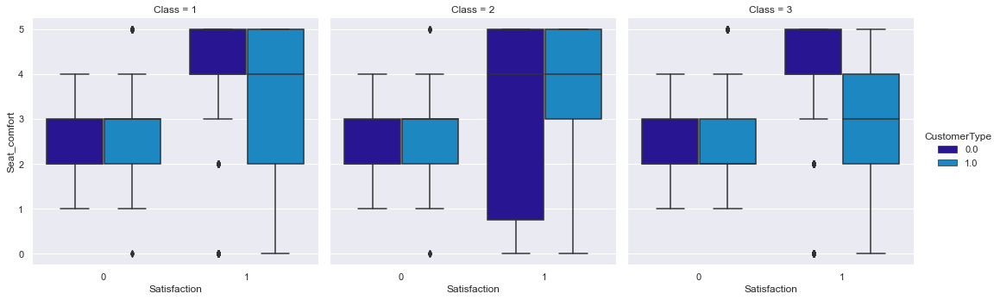

In [96]:
#Evaluating Satisfaction vs. Seat_comfort vs. Class
sns.catplot(x="Satisfaction",
               y = "Seat_comfort",
               hue="CustomerType", 
               col="Class", 
               data=df, 
               kind="box");

# Satisfaction: 0:Neutral or Dissatisfied; 1:Satisfied
# Gender: 1:Male; 2:Female
# CustomerType: 0:Disloyal Customer; 1:Loyal Customer
# Class: 1:Economy; 2:Eco Plus; 3:Business

#### Observations
- Seat_comfort, shows 41.9% of existing customers that consider seats need improvement 
- 19.9% consider extremely poor/poor quality seat comfortability 
- Even for Loyal Customers (mainly females), the satisfaction regarding the seats is notoriously low 

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Data Preparation

### Split the dataset into train and test sets

In [92]:
#Dropping CustomerId column after EDA
df.drop(columns='CustomerId',inplace=True)

In [93]:
#Dropping ArrivalDelayin_Mins column after EDA
df.drop(columns='ArrivalDelayin_Mins',inplace=True)

In [94]:
#Separating target variable and other variables
X=df.drop(columns='Satisfaction')
Y=df['Satisfaction']

In [95]:
#Splitting the data into train and test sets
X_train,X_test,y_train,y_test=train_test_split(X,Y,test_size=0.30,random_state=1,stratify=Y)

### Outlier Treatment for Quantitative Variables

In [96]:
def treat_outliers(df,col):
    '''
    treats outliers in a variable
    col: str, name of the numerical varaible
    df: data frame
    col: name of the column
    '''
    Q1=df[col].quantile(0.25) # 25th quantile
    Q3=df[col].quantile(0.75)  # 75th quantile
    IQR=Q3-Q1
    Lower_Whisker = Q1 - 1.5*IQR 
    Upper_Whisker = Q3 + 1.5*IQR
    df[col] = np.clip(df[col], Lower_Whisker, Upper_Whisker) # all the values smaller than Lower_Whisker will be assigned value of Lower_whisker 
                                                            # and all the values above upper_whishker will be assigned value of upper_Whisker 
    return df

def treat_outliers_all(df, col_list):
    '''
    treat outlier in all numerical variables
    col_list: list of numerical varaibles
    df: data frame
    '''
    for c in col_list:
        df = treat_outliers(df,c)
        
    return df

In [97]:
numerical_col = df.select_dtypes(include=np.number).columns.tolist()# getting list of numerical columns
  
# items to be removed 
unwanted= {'CustomerId', 'Satisfaction', 'Seat_comfort', 'Departure.Arrival.time_convenient', 'Food_drink', 'Gate_location', 'Inflightwifi_service', 'Inflight_entertainment', 'Online_support', 'Ease_of_Onlinebooking', 'Onboard_service', 'Leg_room_service', 'Baggage_handling', 'Checkin_service', 'Cleanliness', 'Online_boarding', 'Gender', 'CustomerType', 'Age', 'TypeTravel', 'Class'} # keeping these columns as it is (no influcence of outliers in this numerical variable)
  
numerical_col = [ele for ele in numerical_col if ele not in unwanted] 
df = treat_outliers_all(df,numerical_col)

#### Validating Outlier Treatment for Quantitative Variables

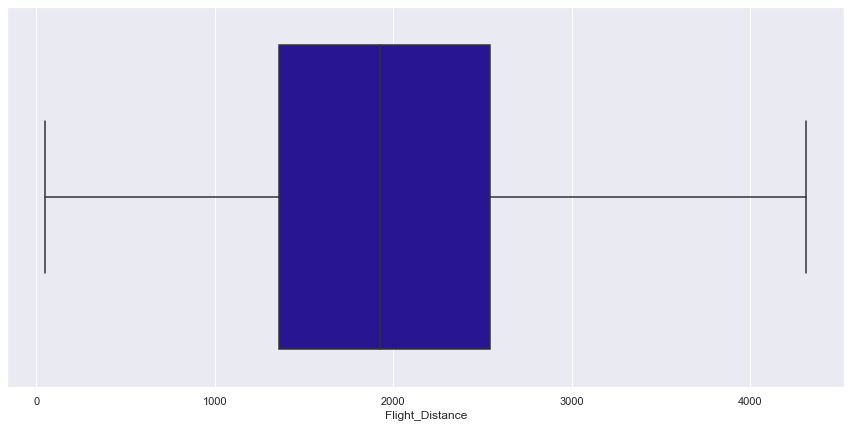

In [98]:
sns.boxplot(df["Flight_Distance"])

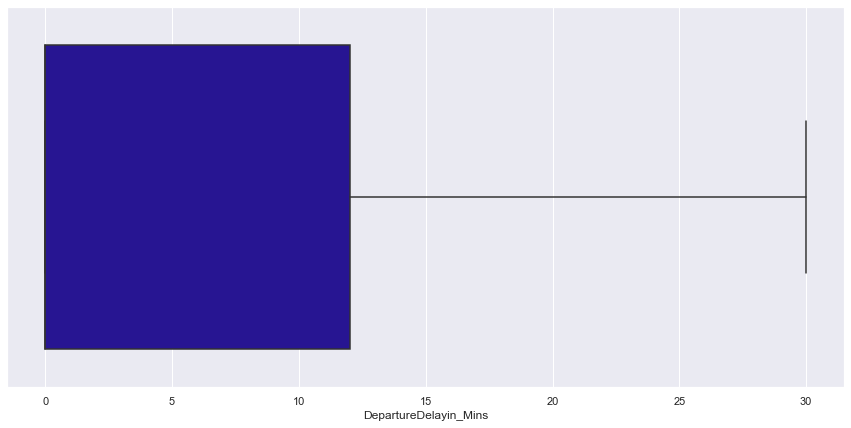

In [99]:
sns.boxplot(df["DepartureDelayin_Mins"])

#### Observations
* Outliers have been treated in dataset

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Model Building

### Model evaluation criterion:

#### Model can make wrong predictions as:
1. Predicting a customer as Satisfied but the customer is Dissatisfied - Wrong Customer Profile Features
2. Predicting a customer as Dissatisfied and the customer is Satisfied - Loss of Opportunity

#### Which case is more important? 
* Predicting that a customer is Dissatisfied but is Satisfied is the worst scenario for the airline. In this case,  the company is losing on a potential source of income because that customer will not be targeted by the marketing team when he should be targeted.

#### How to reduce this loss, i.e., need to reduce False Negatives?
* Company wants Recall to be maximized; greater the Recall, lesser the chances of false negatives.

**Let's create two functions to calculate different metrics and confusion matrix, so that we don't have to use the same code repeatedly for each model.**

In [100]:
##  Function to calculate different metric scores of the model - Accuracy, Recall and Precision
def get_metrics_score(model,flag=True):
    '''
    model : classifier to predict values of X

    '''
    # defining an empty list to store train and test results
    score_list=[] 
    
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)
    
    train_acc = model.score(X_train,y_train)
    test_acc = model.score(X_test,y_test)
    
    train_recall = metrics.recall_score(y_train,pred_train)
    test_recall = metrics.recall_score(y_test,pred_test)
    
    train_precision = metrics.precision_score(y_train,pred_train)
    test_precision = metrics.precision_score(y_test,pred_test)
    
    score_list.extend((train_acc,test_acc,train_recall,test_recall,train_precision,test_precision))
        
    # If the flag is set to True then only the following print statements will be dispayed. The default value is set to True.
    if flag == True: 
        print("Accuracy on training set : ",model.score(X_train,y_train))
        print("Accuracy on test set : ",model.score(X_test,y_test))
        print("Recall on training set : ",metrics.recall_score(y_train,pred_train))
        print("Recall on test set : ",metrics.recall_score(y_test,pred_test))
        print("Precision on training set : ",metrics.precision_score(y_train,pred_train))
        print("Precision on test set : ",metrics.precision_score(y_test,pred_test))
    
    return score_list # returning the list with train and test scores

In [101]:
## Function to create confusion matrix
def make_confusion_matrix(model,y_actual,labels=[1, 0]):
    '''
    model : classifier to predict values of X
    y_actual : ground truth  
    
    '''
    y_predict = model.predict(X_test)
    cm=metrics.confusion_matrix( y_actual, y_predict, labels=[0, 1])
    df_cm = pd.DataFrame(cm, index = [i for i in ["Actual - No","Actual - Yes"]],
                  columns = [i for i in ['Predicted - No','Predicted - Yes']])
    group_counts = ["{0:0.0f}".format(value) for value in
                cm.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in
                         cm.flatten()/np.sum(cm)]
    labels = [f"{v1}\n{v2}" for v1, v2 in
              zip(group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    plt.figure(figsize = (10,7))
    sns.heatmap(df_cm, annot=labels,fmt='')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

## Model Selection

* Since the data set contains inputs (independent variables) and the desired outputs (Overall Customer Satisfaction), we have decided to use a Supervised Machine Learning Model
* We will calculate all three metrics - Accuracy, Precision, and Recall, but the metric of interest here is recall
* Recall - It gives the ratio of True positives to Actual positives, so high Recall implies low false negatives

### Machine Learning Methods: Supervised Learning - Decision Tree, Random Forest, Bagging & Boosting
* We have decided to use Decision Tree, Random Forest, Bagging and Boosting models. 
* Decision Tree will segment the data set into a number of regions in the multidimensional space in order to minimize the impurity of the regions
* Since Decision Trees tends to overfit data, we will use Random Forest in our evaluation, This model selects a subset of the columns every time it looks for a split or branching to have a more robust prediction bootstraping (sampling) from the data
* Bagging models use small samples to execute models in parallel. Boosting models collect a bunch of data to analyze in smaller groups, works in sequence, improving the data 
* After performing all the above models, we will use the Stacking Classifier which stacks the output of individual estimators and use a classifier to compute the final prediction. Stacking allows to use the strength of each individual estimator by using their output as input of a final estimator

### Bagging Models
We are going to build 3 ensemble models here - Decision Tree Classifier, Bagging Classifier and Random Forest Classifier
First, let's build these models with default parameters and then use hyperparameter tuning to optimize the model performance


### Boosting Models
We are going to build 3 ensemble models here - AdaBoost Classifier, Gradient Boosting Classifier, and XGBoost Classifier
First, let's build these models with default parameters and then use hyperparameter tuning to optimize the model performance

### Hyperparameter Tuning
We will use pipelines with StandardScaler with bagging and boosting models and tune them using GridSearchCV and RandomizedSearchCV. We will also compare the performance and time taken by these two methods - grid search and randomized search.

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Decision Tree & Hyperparameter Tuning

Accuracy on training set :  1.0
Accuracy on test set :  0.9279586449626045
Recall on training set :  1.0
Recall on test set :  0.9364994306383548
Precision on training set :  1.0
Precision on test set :  0.932190958794506


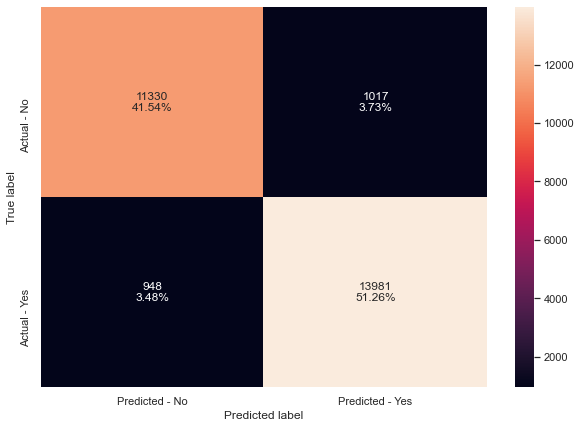

In [102]:
#Fitting the model
d_tree = DecisionTreeClassifier(random_state=1)
d_tree.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(d_tree)

#Creating confusion matrix
make_confusion_matrix(d_tree,y_test)

- The model is overfitting the training data as training recall/precision is higher than the test recall/precision

### Cost Complexity Pruning

**Let's try pruning the tree and see if the performance improves.**

In [103]:
path = d_tree.cost_complexity_pruning_path(X_train, y_train)

ccp_alphas, impurities = path.ccp_alphas, path.impurities

In [104]:
clfs_list = []

for ccp_alpha in ccp_alphas:
    clf = DecisionTreeClassifier(random_state=1, ccp_alpha=ccp_alpha)
    clf.fit(X_train, y_train)
    clfs_list.append(clf)

print("Number of nodes in the last tree is: {} with ccp_alpha: {}".format(clfs_list[-1].tree_.node_count, ccp_alphas[-1]))

Number of nodes in the last tree is: 1 with ccp_alpha: 0.17918668897406503


In [105]:
#Fitting model for each value of alpha and saving the train recall in a list 
recall_train=[]
for clf in clfs_list:
    pred_train=clf.predict(X_train)
    values_train=metrics.recall_score(y_train,pred_train)
    recall_train.append(values_train)

In [106]:
#Fitting model for each value of alpha and saving the test recall in a list
recall_test=[]
for clf in clfs_list:
    pred_test=clf.predict(X_test)
    values_test=metrics.recall_score(y_test,pred_test)
    recall_test.append(values_test)

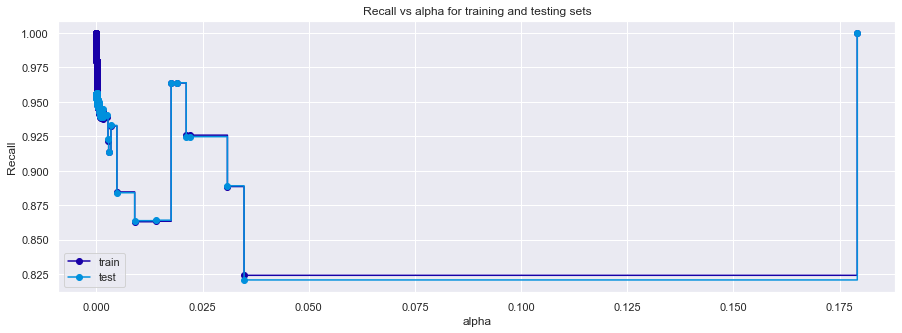

In [107]:
#Plotting the graph for Recall VS alpha 
fig, ax = plt.subplots(figsize=(15,5))
ax.set_xlabel("alpha")
ax.set_ylabel("Recall")
ax.set_title("Recall vs alpha for training and testing sets")
ax.plot(ccp_alphas, recall_train, marker='o', label="train",
        drawstyle="steps-post")
ax.plot(ccp_alphas, recall_test, marker='o', label="test",
        drawstyle="steps-post")
ax.legend()
plt.show()

Accuracy on training set :  0.5473201238195503
Accuracy on test set :  0.5473309869482329
Recall on training set :  1.0
Recall on test set :  1.0
Precision on training set :  0.5473201238195503
Precision on test set :  0.5473309869482329


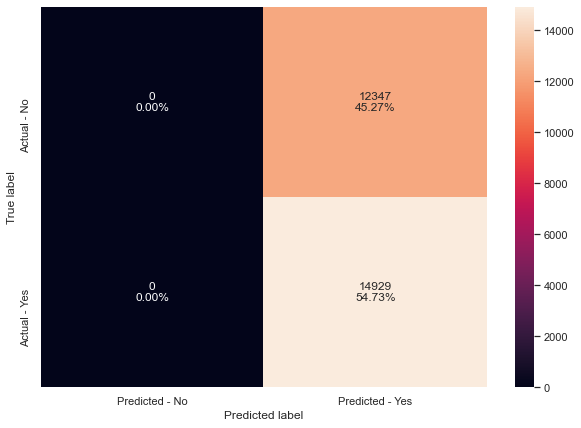

In [108]:
#Creating the model where we get highest test recall
index_best_pruned_model = np.argmax(recall_test)

pruned_dtree_model = clfs_list[index_best_pruned_model]

get_metrics_score(pruned_dtree_model)

make_confusion_matrix(pruned_dtree_model,y_test)

- We can see from the graph plotted above that maximum test recall is for the model without pruning i.e. alpha=0
- There is no improvement in the model performance as the best pruned model fitted is the same as we built initially. 
- Let's try hyperparameter tuning, with class weights to compensate for the imbalanced data, and see if the model performance improves.

### Hyperparameter Tuning

In [109]:
#Choose the type of classifier. 
dtree_estimator = DecisionTreeClassifier(class_weight={0:0.18,1:0.72},random_state=1)

# Grid of parameters to choose from
parameters = {'max_depth': np.arange(2,30), 
              'min_samples_leaf': [1, 2, 5, 7, 10],
              'max_leaf_nodes' : [2, 3, 5, 10,15],
              'min_impurity_decrease': [0.0001,0.001,0.01,0.1]
             }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(dtree_estimator, parameters, scoring=scorer,n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
dtree_estimator = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
dtree_estimator.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.18, 1: 0.72}, max_depth=2,
                       max_leaf_nodes=2, min_impurity_decrease=0.0001,
                       random_state=1)

Accuracy on training set :  0.5473201238195503
Accuracy on test set :  0.5473309869482329
Recall on training set :  1.0
Recall on test set :  1.0
Precision on training set :  0.5473201238195503
Precision on test set :  0.5473309869482329


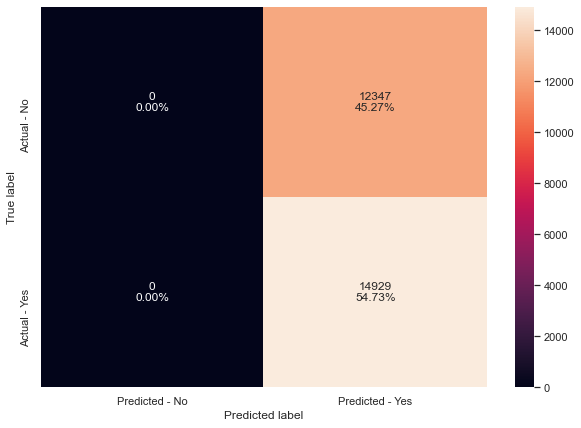

In [110]:
get_metrics_score(dtree_estimator)

make_confusion_matrix(dtree_estimator,y_test)

- The model is not generalizing well and overfits the training/test recall 
- Recall values are too high compared to accuracy and precision
- The model is not good at predicting customer satisfaction

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Random Forest & Hyperparameter Tuning

## Random Forest Classifier

Accuracy on training set :  1.0
Accuracy on test set :  0.95101921102801
Recall on training set :  1.0
Recall on test set :  0.949628240337598
Precision on training set :  1.0
Precision on test set :  0.9604362848045526


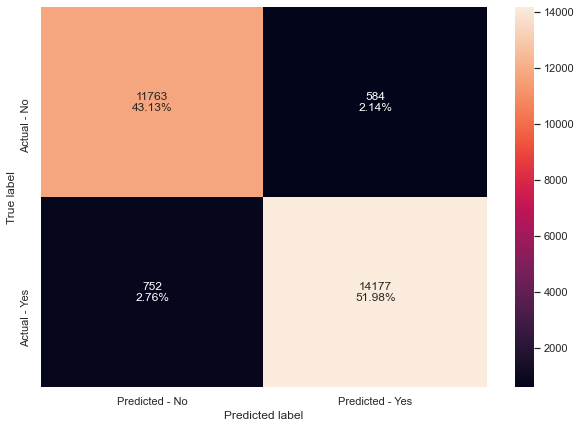

In [111]:
#Fitting the model
rf_estimator = RandomForestClassifier(random_state=1)
rf_estimator.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(rf_estimator)

#Creating confusion matrix
make_confusion_matrix(rf_estimator,y_test)

- With default parameters, random forest is performing better than decision tree in terms of precision, accuracy and, recall
- The model is overfitting the training data
- We'll try to reduce overfitting and improve recall by hyperparameter tuning

### Hyperparameter Tuning

In [112]:
# Choose the type of classifier. 
rf_tuned = RandomForestClassifier(class_weight={0:0.18,1:0.82},random_state=1,oob_score=True,bootstrap=True)

parameters = {  
                'max_depth': list(np.arange(5,30,5)) + [None],
                'max_features': ['sqrt','log2',None],
                'min_samples_leaf': np.arange(1,15,5),
                'min_samples_split': np.arange(2, 20, 5),
                'n_estimators': np.arange(10,110,10)}


# Run the grid search
grid_obj = GridSearchCV(rf_tuned, parameters, scoring='recall',cv=5,n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
rf_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
rf_tuned.fit(X_train, y_train)

RandomForestClassifier(class_weight={0: 0.18, 1: 0.82}, max_depth=15,
                       max_features='sqrt', min_samples_leaf=11,
                       n_estimators=90, oob_score=True, random_state=1)

Accuracy on training set :  0.9185273644348769
Accuracy on test set :  0.9087109546854377
Recall on training set :  0.9923920532843362
Recall on test set :  0.984593743720276
Precision on training set :  0.875402031048193
Precision on test set :  0.8667374255557521


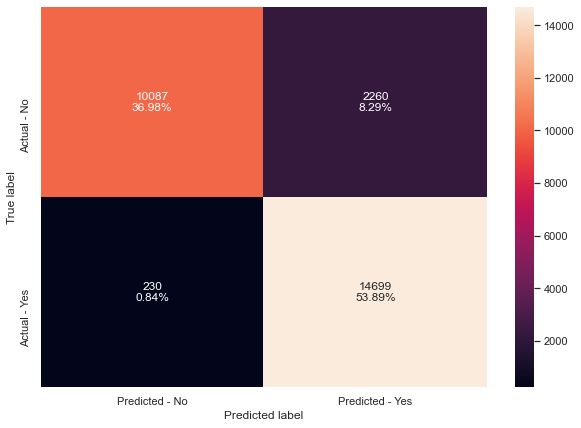

In [113]:
#Calculating different metrics
get_metrics_score(rf_tuned)

#Creating confusion matrix
make_confusion_matrix(rf_tuned,y_test)

- The overfitting has reduced after tuning the model
- The Random Forest Classifier with hyperparameter tuning is generalizing well and is not overfitting the training data
- The model is good at forecasting customer satisfaction, but recall is not too high compared with accuracy and precision

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Bagging Models & Hyperparameter Tuning

## Bagging Classifier

Accuracy on training set :  0.9963074118885624
Accuracy on test set :  0.9443466783985922
Recall on training set :  0.9942581534221405
Recall on test set :  0.9367003818072208
Precision on training set :  0.9989903943231315
Precision on test set :  0.9606374939891461


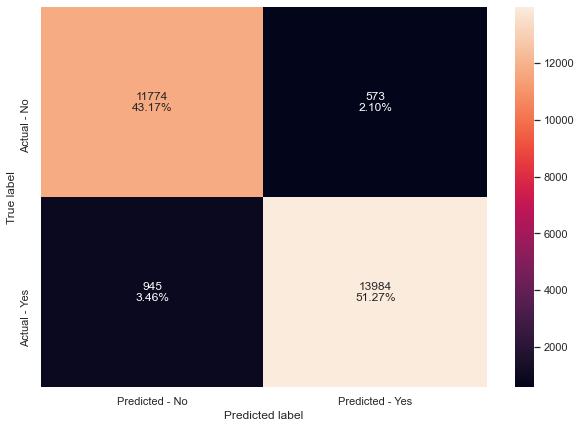

In [114]:
#Fitting the model
bagging_classifier = BaggingClassifier(random_state=1)
bagging_classifier.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(bagging_classifier)

#Creating confusion matrix
make_confusion_matrix(bagging_classifier,y_test)

- With default parameters, bagging classifier is generalizing well 
- The model default model has less recall than the Random Forest with hyperparameter tuning
- We'll try improve recall by hyperparameter tuning

### Hyperparameter Tuning

In [115]:
# Choose the type of classifier. 
bagging_estimator_tuned = BaggingClassifier(random_state=1)

# Grid of parameters to choose from
parameters = {'max_samples': [0.7,0.8,0.9,1], 
              'max_features': [0.7,0.8,0.9,1],
              'n_estimators' : [10,20,30,40,50],
             }

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(bagging_estimator_tuned, parameters, scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
bagging_estimator_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
bagging_estimator_tuned.fit(X_train, y_train)

BaggingClassifier(max_features=0.8, max_samples=0.9, n_estimators=50,
                  random_state=1)

Accuracy on training set :  0.5473201238195503
Accuracy on test set :  0.5473309869482329
Recall on training set :  1.0
Recall on test set :  1.0
Precision on training set :  0.5473201238195503
Precision on test set :  0.5473309869482329


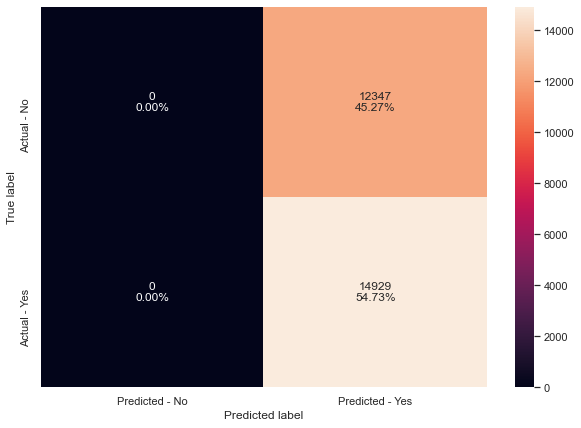

In [116]:
#Calculating different metrics
get_metrics_score(bagging_estimator_tuned)

#Creating confusion matrix
make_confusion_matrix(bagging_estimator_tuned,y_test)

- The model with hyperparameter tuning is generalizing well and is not overfitting the training/test recall 
- The Bagging Classifier with hyperparameter tuning has a lower recall compared to  the Random Forest with hyperparameter tuning
- The model is good at forecasting customer satisfaction

<span style="font-family: Arial; font-weight:bold;font-size:2em;color:#00b3e5;">Boosting Models & Hyperparameter Tuning

## AdaBoost Classifier

Accuracy on training set :  0.8965289671752487
Accuracy on test set :  0.8963557706408565
Recall on training set :  0.9028479559026182
Recall on test set :  0.9029405854377386
Precision on training set :  0.9076163814251493
Precision on test set :  0.9072553506528469


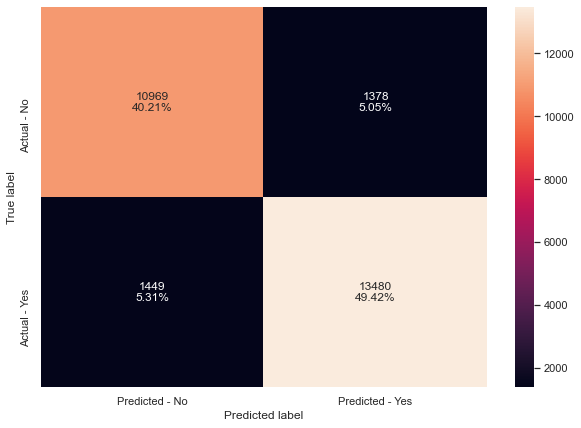

In [117]:
#Fitting the model
ab_classifier = AdaBoostClassifier(random_state=1)
ab_classifier.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(ab_classifier)

#Creating confusion matrix
make_confusion_matrix(ab_classifier,y_test)

- The model is generalizing well but is giving a lower recall (test data)
- We will try to enhance the recall value applying the hyperparameter tuning to Adaboost

### Hyperparameter Tuning

In [37]:
# Choose the type of classifier. 
abc_tuned = AdaBoostClassifier(random_state=1)

# Grid of parameters to choose from
parameters = {
    #Let's try different max_depth for base_estimator
    "base_estimator":[DecisionTreeClassifier(max_depth=1),DecisionTreeClassifier(max_depth=2),
                      DecisionTreeClassifier(max_depth=3)],
    "n_estimators": np.arange(10,110,10),
    "learning_rate":np.arange(0.1,2,0.1)
}

# Type of scoring used to compare parameter  combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(abc_tuned, parameters, scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
abc_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
abc_tuned.fit(X_train, y_train)

AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3),
                   learning_rate=1.5000000000000002, n_estimators=100,
                   random_state=1)

Accuracy on training set :  0.9480209299036785
Accuracy on test set :  0.9423669159700836
Recall on training set :  0.9505339917317409
Recall on test set :  0.9468819076964298
Precision on training set :  0.9543148671239984
Precision on test set :  0.9477707006369427


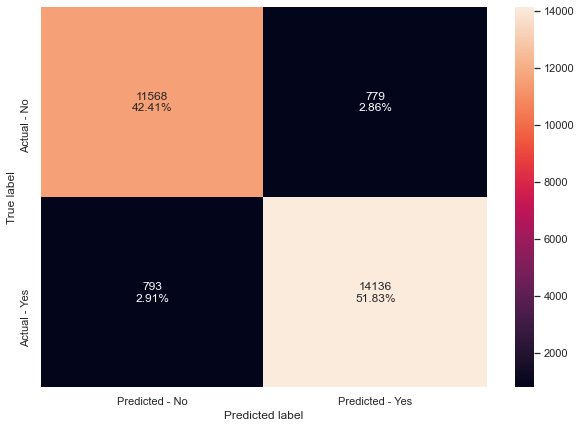

In [119]:
#Calculating different metrics
get_metrics_score(abc_tuned)

#Creating confusion matrix
make_confusion_matrix(abc_tuned,y_test)

- The Adaboost Classifier with hyperparameter tuning recall value improved but still lower compared to other models

## Gradient Boosting Classifier

Accuracy on training set :  0.9214028692195283
Accuracy on test set :  0.9212494500659921
Recall on training set :  0.9286862655029857
Recall on test set :  0.9285283676066716
Precision on training set :  0.9277806459014513
Precision on test set :  0.927658435387807


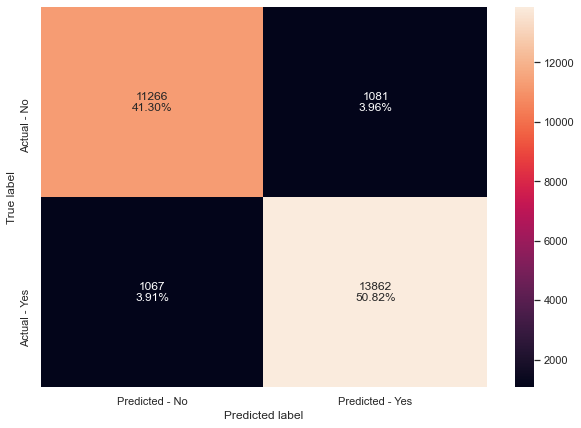

In [120]:
#Fitting the model
gb_classifier = GradientBoostingClassifier(random_state=1)
gb_classifier.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(gb_classifier)

#Creating confusion matrix
make_confusion_matrix(gb_classifier,y_test)

- The model is not overfitting the data but is giving a relatively low recall compared to other models 
- The recall is better as compared to the Tuned AdaBoost but still not great

### Hyperparameter Tuning

In [37]:
# Choose the type of classifier. 
gbc_tuned = GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),random_state=1)

# Grid of parameters to choose from
parameters = {
    "n_estimators": [100,150,200,250],
    "subsample":[0.8,0.9,1],
    "max_features":[0.7,0.8,0.9,1]
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(gbc_tuned, parameters, scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
gbc_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
gbc_tuned.fit(X_train, y_train)

GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),
                           max_features=0.8, n_estimators=250, random_state=1,
                           subsample=0.9)

Accuracy on training set :  0.9363460662151758
Accuracy on test set :  0.9352910984015251
Recall on training set :  0.9404857602204869
Recall on test set :  0.9407863889074954
Precision on training set :  0.9430578345856003
Precision on test set :  0.9409754790298808


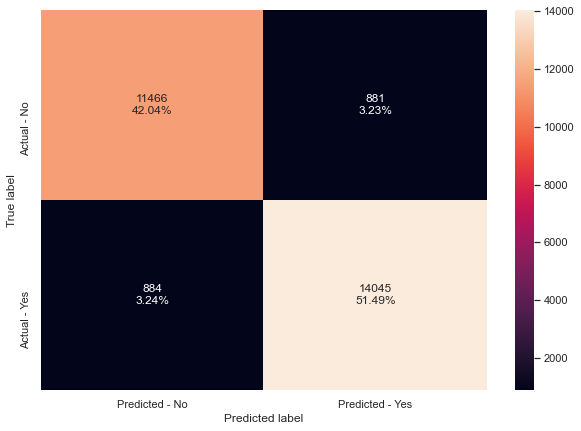

In [122]:
#Calculating different metrics
get_metrics_score(gbc_tuned)

#Creating confusion matrix
make_confusion_matrix(gbc_tuned,y_test)

- The model performance has not improved by much after hyperparameter tuning

## XGBoost Classifier

[08:12:55] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy on training set :  0.9717949120849767
Accuracy on test set :  0.9525590262501833
Recall on training set :  0.969080156178227
Recall on test set :  0.951704735749213
Precision on training set :  0.9791721057059147
Precision on test set :  0.9612340166429876


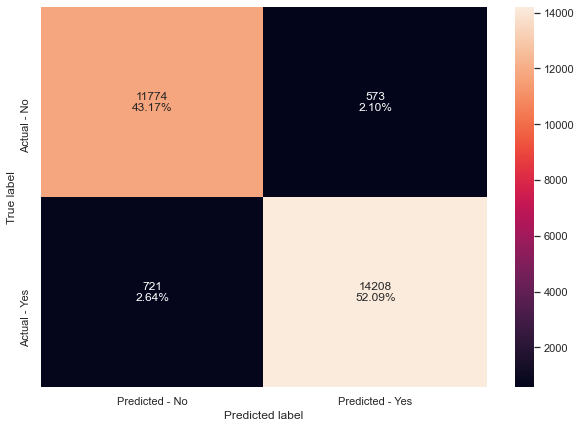

In [123]:
#Fitting the model
xgb_classifier = XGBClassifier(random_state=1)
xgb_classifier.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(xgb_classifier)

#Creating confusion matrix
make_confusion_matrix(xgb_classifier,y_test)

- The default model is not overfitting the data but is giving equivalent results compared to other models

### Hyperparameter Tuning

In [37]:
# Choose the type of classifier. 
xgb_tuned = XGBClassifier(random_state=1)

# Grid of parameters to choose from
parameters = {
    "n_estimators": np.arange(10,100,20),
    "scale_pos_weight":[0,1,2,5],
    "subsample":[0.5,0.7,0.9,1],
    "learning_rate":[0.01,0.1,0.2,0.05],
    "gamma":[0,1,3],
    "colsample_bytree":[0.5,0.7,0.9,1],
    "colsample_bylevel":[0.5,0.7,0.9,1]
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(xgb_tuned, parameters,scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
xgb_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
xgb_tuned.fit(X_train, y_train)

[21:26:10] WARNING: ..\src\learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:26:10] WARNING: ..\src\learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:26:10] WARNING: ..\src\learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:26:10] WARNING: ..\src\learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old be

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=0.7,
              colsample_bynode=1, colsample_bytree=0.5, gamma=3, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.01, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=30, n_jobs=8, num_parallel_tree=1, random_state=1,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=5, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

Accuracy on training set :  0.8438270925975393
Accuracy on test set :  0.8422789265288165
Recall on training set :  0.986564079007809
Recall on test set :  0.986469287963025
Precision on training set :  0.783939774153074
Precision on test set :  0.7822276517767037


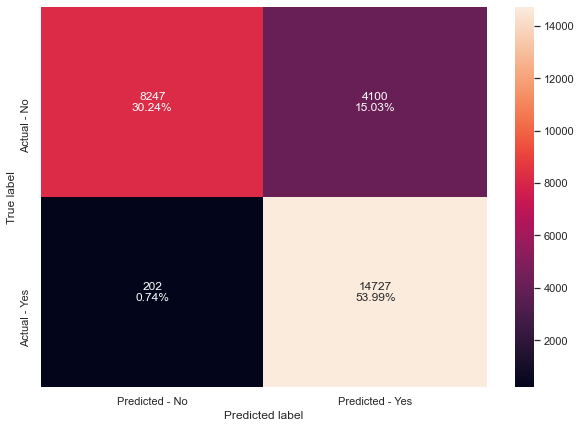

In [125]:
#Calculating different metrics
get_metrics_score(xgb_tuned)

#Creating confusion matrix
make_confusion_matrix(xgb_tuned,y_test)

- The model performance has improved after hyperparameter tuning and it is the best performance reached until now
- Let's try one more model - Stacking classifier.

## Stacking Classifier

- Stacking classifier stacks the output of individual estimators and use a classifier to compute the final prediction
- Stacking allows to use the strength of each individual estimator by using their output as input of a final estimator

In [126]:
estimators = [('Random Forest',rf_tuned), ('Gradient Boosting',gbc_tuned), ('Decision Tree',dtree_estimator)]

final_estimator = xgb_tuned

stacking_classifier= StackingClassifier(estimators=estimators,final_estimator=final_estimator)

stacking_classifier.fit(X_train,y_train)

[07:41:13] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


StackingClassifier(estimators=[('Random Forest',
                                RandomForestClassifier(class_weight={0: 0.18,
                                                                     1: 0.82},
                                                       max_depth=25,
                                                       max_features='sqrt',
                                                       min_samples_leaf=11,
                                                       n_estimators=60,
                                                       oob_score=True,
                                                       random_state=1)),
                               ('Gradient Boosting',
                                GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),
                                                           max_features=0.7,
                                                           n_estimators=250,
                                                  

Accuracy on training set :  0.8991059222828051
Accuracy on test set :  0.8943760082123479
Recall on training set :  0.9933681672025724
Recall on test set :  0.9887467345435059
Precision on training set :  0.8482508396460003
Precision on test set :  0.8447407576971501


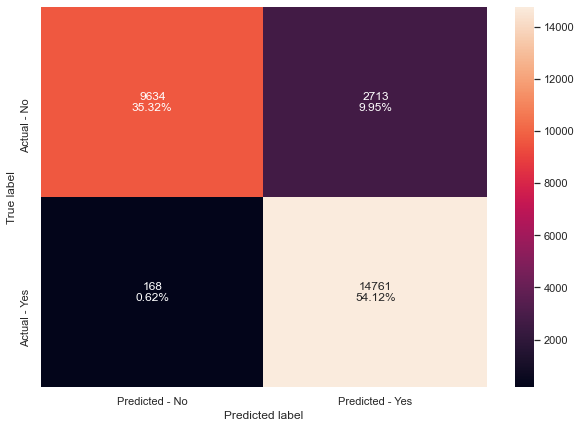

In [127]:
#Calculating different metrics
get_metrics_score(stacking_classifier)

#Creating confusion matrix
make_confusion_matrix(stacking_classifier,y_test)

- Stacking classifier has further increased the recall that we got from xgboost model and increased the precision as well
- Model is slightly overfitting the training data

## Comparing all models

In [67]:
# defining list of models
models = [d_tree, pruned_dtree_model, dtree_estimator,rf_estimator, rf_tuned, bagging_classifier,bagging_estimator_tuned,
          ab_classifier, abc_tuned, gb_classifier, gbc_tuned, xgb_classifier,xgb_tuned, stacking_classifier]

# defining empty lists to add train and test results
acc_train = []
acc_test = []
recall_train = []
recall_test = []
precision_train = []
precision_test = []

# looping through all the models to get the metrics score - Accuracy, Recall and Precision
for model in models:
    
    j = get_metrics_score(model,False)
    acc_train.append(j[0])
    acc_test.append(j[1])
    recall_train.append(j[2])
    recall_test.append(j[3])
    precision_train.append(j[4])
    precision_test.append(j[5])

In [129]:
comparison_frame = pd.DataFrame({'Model':['Decision Tree','Decision Tree Pruned','Tuned Decision Tree','Random Forest','Tuned Random Forest',
                                          'Bagging Classifier','Bagging Classifier Tuned','AdaBoost Classifier','Tuned AdaBoost Classifier',
                                          'Gradient Boosting Classifier', 'Tuned Gradient Boosting Classifier',
                                          'XGBoost Classifier',  'Tuned XGBoost Classifier', 'Stacking Classifier'], 
                                          'Train_Accuracy': acc_train,'Test_Accuracy': acc_test,
                                          'Train_Recall':recall_train,'Test_Recall':recall_test,
                                          'Train_Precision':precision_train,'Test_Precision':precision_test}) 

#Sorting models in decreasing order of test recall
comparison_frame.sort_values(by='Test_Recall',ascending=False)

,Model,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision
1,Decision Tree Pruned,0.547320,0.547331,1.000000,1.000000,0.547320,0.547331
2,Tuned Decision Tree,0.547320,0.547331,1.000000,1.000000,0.547320,0.547331
6,Bagging Classifier Tuned,0.547320,0.547331,1.000000,1.000000,0.547320,0.547331
13,Stacking Classifier,0.899106,0.894376,0.993368,0.988747,0.848251,0.844741
12,Tuned XGBoost Classifier,0.843827,0.842279,0.986564,0.986469,0.783940,0.782228
4,Tuned Random Forest,0.918527,0.908711,0.992392,0.984594,0.875402,0.866737
11,XGBoost Classifier,0.971795,0.952559,0.969080,0.951705,0.979172,0.961234
3,Random Forest,1.000000,0.951019,1.000000,0.949628,1.000000,0.960436
8,Tuned AdaBoost Classifier,0.948021,0.942367,0.950534,0.946882,0.954315,0.947771
10,Tuned Gradient Boosting Classifier,0.936346,0.935291,0.940486,0.940786,0.943058,0.940975


#### Observations
- The Stacking Classifier is giving the highest Recall on test data, and it is not overfitting (98.97%)
- The Stacking Classifier model is decreasing the number of false negatives and increased the number of false positives
- Decision Tree Pruned, Decision Tree Tunes, Bagging Classifier Tuned show a higher Test/Train Recall, but the models are overfitting the train data. For this reason, we must ignore their results

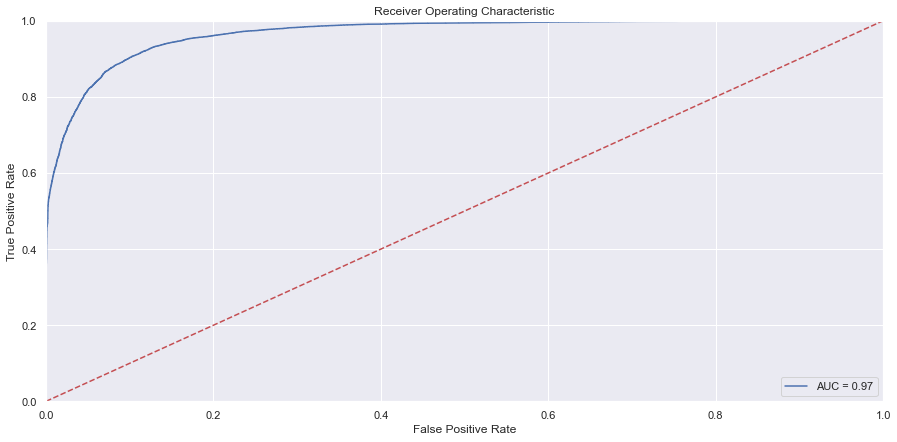

In [130]:
#AUC ROC curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve

import sklearn.metrics as metrics
# calculate the fpr and tpr for all thresholds of the classification
probs = stacking_classifier.predict_proba(X_test)
preds = probs[:,1]
fpr, tpr, threshold = metrics.roc_curve(y_test, preds)
roc_auc = metrics.auc(fpr, tpr)

# method I: plt
import matplotlib.pyplot as plt
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()


- The area under the curve (AUC) is 0.97
- Recall on train data is 0.993368 and on test data is 0.988747, which shows that the model is performing well and is not overfitting
- Stacking Classifier is the best predictor for the passenger satisfaction

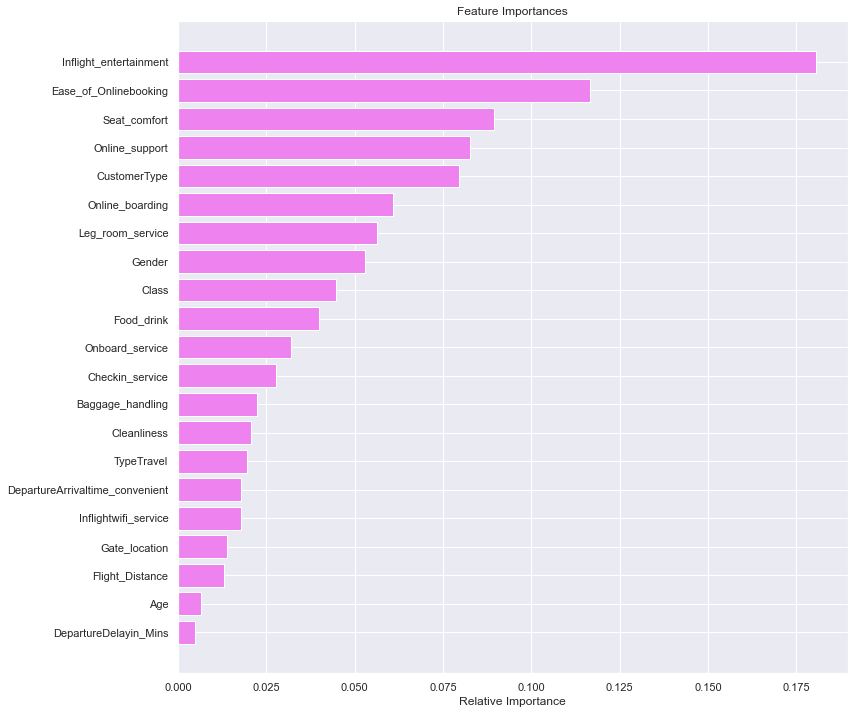

In [132]:
feature_names = X_train.columns
importances = stacking_classifier.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

- Inflight_Entertainment is the most important feature, followed Ease_of_Onlinebooking and Seat_comfort

# Business Recommendation

- On average, 26.1% of the existing customers consider that the Inflight_entertainment at least needs improvement. Loyal Customers of any Gender consider Inflight Entertainment as good or excellent.  However, Disloyal Customers, the potential market to penetrate, consider inflight entertainment as mediocre, especially the male public. Since these variables have a high impact on the satisfaction rate, developing a strategy to improve the inflight activities (movies, TV shows, music, free library, high-quality internet, etc.) will positively impact the operation
- 25.6% of the customers considered that Ease_of_Onlinebooking at least needs improvement. The EDA shows that this variable is sensible, due to dissatisfied customers with this variable, in the majority, were dissatisfied with the whole flight experience. In correlation with the Online_Support variable (0.68), the customers' perception regarding the online services is an improvement area. Dissatisfied customers, in general, consider the Ease of Online_Booking between acceptable and good. An improvement in the logic of this process could positively impact the market share. The creation or adoption of an app and a simpler interactive online reservation system would be a good solution not only to save time and being more efficient but a booster to increase bookings (income growth) with a modern and smarted look
- In terms of Seat_comfort, a non-depreciable 41.9% of existing customers consider that the seats, at least, need improvement. 19.9% consider extremely poor/poor quality seat comfortability. Even for Loyal Customers (mainly females), the satisfaction regarding the seats is notoriously low. Since this improvement implies a significant investment, our recommendation is to review its business model. We have no information about the income of existing clients. Still, almost 50% are from the Business Class, and this implies that their expectations are above the  Economy and Eco Plus categories. A change in the vision of the company could make a transcendental change in market share and a notorious income growth
- Finally, an important feature to take into consideration is Gender. Approximately 60% of males were dissatisfied with the existing services versus 30% of females. It is important to provide better onboard services targeted by Gender in order to minimize dissatisfaction, mainly in the male public